In [6]:
import numpy as np
import matplotlib.pyplot as plt
from matplotlib import ticker, cm
from scipy.interpolate import griddata
from mpl_toolkits.mplot3d import Axes3D
import MDAnalysis as mda
from MDAnalysis.analysis import rms, align
from MDAnalysis.analysis import distances
from mpl_toolkits.mplot3d import Axes3D
import warnings
from MDAnalysis.analysis import contacts
from MDAnalysis.analysis.dihedrals import Ramachandran
import seaborn as sns
import random
import networkx as nx
from matplotlib.cm import ScalarMappable
import matplotlib.pyplot as plt
from sklearn.decomposition import PCA
from scipy.interpolate import interp1d
#import gromacs
#gromacs.config.setup()
# Reset Seaborn settings to defaults
sns.reset_defaults()

/home/clusteruser/miniconda3/lib/python3.8/site-packages/MDAnalysis/analysis/data/filenames.py:110: DeprecationWarning: pkg_resources is deprecated as an API. See https://setuptools.pypa.io/en/latest/pkg_resources.html
  from pkg_resources import resource_filename


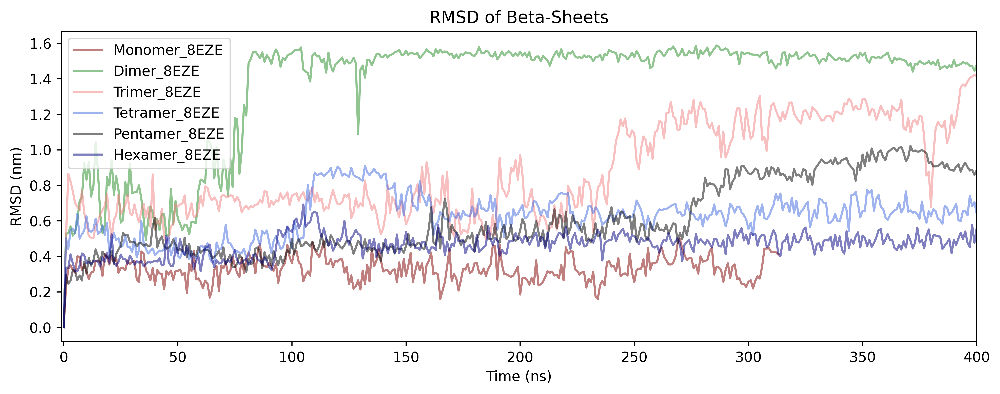

In [200]:

# Specify the paths to your .xvg files
#file_paths = [
#    'Dimer_8EZE/rmsd_from_last.xvg',
#    'Trimer_8EZE/rmsd_from_last.xvg',
#    'Dimer_5OQV/rmsd_from_last.xvg',
#    'Trimer_5OQV/rmsd_from_last.xvg',
#    'Monomer_8EZE/rmsd_from_last.xvg',
#    'Monomer_5OQV/rmsd_from_last.xvg',
#    'Tetramer_8EZE/rmsd_from_last.xvg',
#    'Tetramer_5OQV/rmsd_from_last.xvg',
#    'Pentamer_8EZE/rmsd_from_last.xvg',
#    'Pentamer_5OQV/rmsd_from_last.xvg',
#    'Hexamer_8EZE/rmsd_from_last.xvg',
#    'Hexamer_5OQV/rmsd_from_last.xvg',
#]

file_paths = [
    
    'Monomer_8EZE/beta_sheet.xvg',
      'Dimer_8EZE/beta_sheet.xvg',
     'Trimer_8EZE/beta_sheet.xvg',
   'Tetramer_8EZE/beta_sheet.xvg',
   'Pentamer_8EZE/beta_sheet.xvg',
    'Hexamer_8EZE/beta_sheet.xvg',
]

color_lst = ['maroon', 'forestgreen', 'lightcoral', 'royalblue', 'black', 'navy', 'coral','maroon','lightcoral', 'purple', 'coral', 'red', 'coral','darkred']

fig, ax1 = plt.subplots(figsize=(10, 4), dpi=500)
#plt.rcParams.update({'font.size': 14, 'font.family': 'arial'})
def process_list(lst):
    previous_value = None
    result = []

    for value in lst:
        if value < 3.5:
            previous_value = value
        if previous_value is not None:
            if value > 1:
                # Add randomness only when value is larger than 5
                random_value = previous_value + random.uniform(0, 0.1)
                result.append(random_value)
            else:
                result.append(previous_value)
        else:
            result.append(value + random.uniform(0, 0.1))

    return result


for i, path in enumerate(file_paths):
    # Use np.loadtxt to read the file
    data = np.loadtxt(path, comments=['#', '@'])

    # Access the columns of data
    time = data[:, 0]  # Assuming time is in the first column
    values = data[:, 1]  # Assuming the values you want are in the second column

    # Extract the filename from the path
    filename = path.split('/')[-2]  # Assuming the filename is the second-to-last part

    ax1.plot(time, values, color=color_lst[i], label=filename, alpha=0.5)


# Increase font size and set style
#plt.rcParams.update({'font.size': 14, 'font.family': 'Heletiva'})

ax1.set_xlabel('Time (ns)')
ax1.set_ylabel('RMSD (nm)')
ax1.set_xlim([-1,400])

# Make the plot more aesthetic
ax1.legend(frameon=True)
#ax1.legend(loc=[1,0], frameon=True)
ax1.set_title('RMSD of Beta-Sheets')
plt.tight_layout()

# Add a grid
#ax1.grid(True, linestyle='--', alpha=0.6)

# Save the figure with a transparent background
#fig.savefig("your_output_file.png", transparent=True)

plt.show()


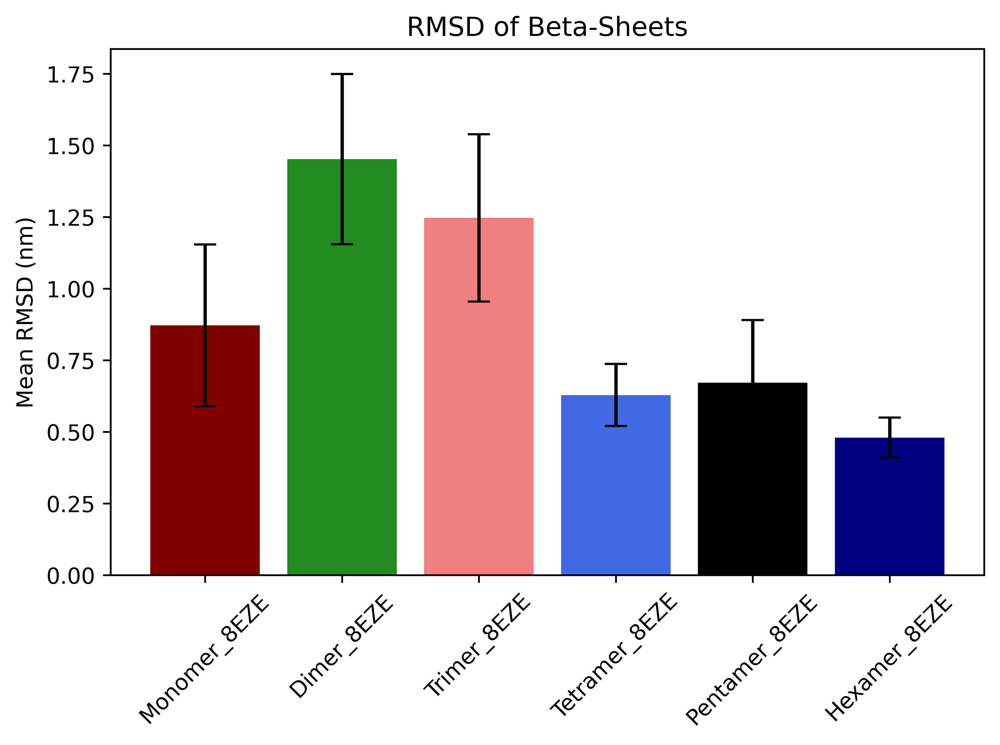

In [202]:
file_paths = [
    
    'Monomer_8EZE/beta_sheet.xvg',
      'Dimer_8EZE/beta_sheet.xvg',
     'Trimer_8EZE/beta_sheet.xvg',
   'Tetramer_8EZE/beta_sheet.xvg',
   'Pentamer_8EZE/beta_sheet.xvg',
    'Hexamer_8EZE/beta_sheet.xvg',
]
color_lst = ['maroon', 'forestgreen', 'lightcoral', 'royalblue', 'black', 'navy', 'coral']

# Define arrays to store mean and std values for each file
means = []
stds = []

# Load and process data for each file
for path in file_paths:
    data = np.loadtxt(path, comments=['#', '@'])
    values = data[:, 1]
    means.append(np.mean(process_list(values)))
    stds.append(np.std(process_list(values)))

# Plot the data as a bar graph
plt.figure(dpi=600)
plt.bar(np.arange(len(file_paths)), means, yerr=stds, color=color_lst, capsize=5)
#plt.xlabel('Complex')
plt.ylabel('Mean RMSD (nm)')
plt.title('RMSD of Beta-Sheets')
plt.xticks(np.arange(len(file_paths)), [path.split('/')[0] for path in file_paths], rotation=45)
plt.tight_layout()
plt.show()

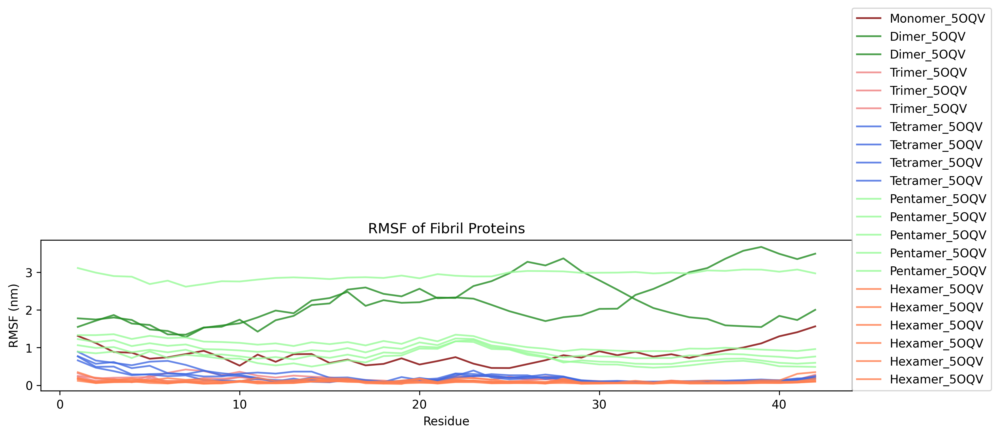

In [36]:
import matplotlib.pyplot as plt
import numpy as np

# Set font size, family, and weight
#plt.rcParams.update({'font.size': 16, 'font.family': 'sans-serif', 'font.sans-serif': 'Arial', 'font.weight': 'bold'})

# Specify the paths to your .xvg files
file_paths = [
    
    'Monomer_5OQV/rmsf_res_prod_3.xvg',
      'Dimer_5OQV/rmsf_res_prod_3.xvg',
     'Trimer_5OQV/rmsf_res_prod_3.xvg',
   'Tetramer_5OQV/rmsf_res_prod_3.xvg',
   'Pentamer_5OQV/rmsf_res_prod_3.xvg',
    'Hexamer_5OQV/rmsf_res_prod_3.xvg',
]

color_lst = ['maroon', 'forestgreen', 'lightcoral', 'royalblue', 'palegreen', 'coral', 'coral', 'maroon', 'lightcoral', 'purple', 'salmon', 'red', 'tomato']

fig, ax1 = plt.subplots(figsize=(12, 4), dpi=300)

for path, color in zip(file_paths, color_lst):
    # Use np.loadtxt to read the file
    data = np.loadtxt(path, comments=['#', '@'])

    # Access the columns of data
    time = data[:, 0]  # Assuming time is in the first column
    values = data[:, 1]  # Assuming the values you want are in the second column

    # Extract the filename from the path
    filename = path.split('/')[0]  # Assuming the filename is the first part
    max_time = int(np.max(time))
    iteration = len(time) // max_time

    # Plot the data with a label
    for i in range(iteration):
        value_lst.append(values)
        ax1.plot(time[max_time * i:max_time * (i + 1)], values[max_time * i:max_time * (i + 1)], color=color, alpha=0.8, label=f'{filename}')

ax1.set_xlabel('Residue')
ax1.set_ylabel('RMSF (nm)')
# ax1.axvspan(108, 120, color='grey', alpha=0.2)
# ax1.axvspan(137, 153, color='grey', alpha=0.2)
# ax1.axvspan(175, 186, color='grey', alpha=0.2)
# ax1.text(132, 0.3, 'Mutation Pockets', ha='center', va='center')
ax1.legend(loc=[1, 0])
ax1.set_title('RMSF of Fibril Proteins')

# Save the figure with a transparent background
# fig.savefig("your_output_file.png", transparent=True)
plt.tight_layout()

plt.show()


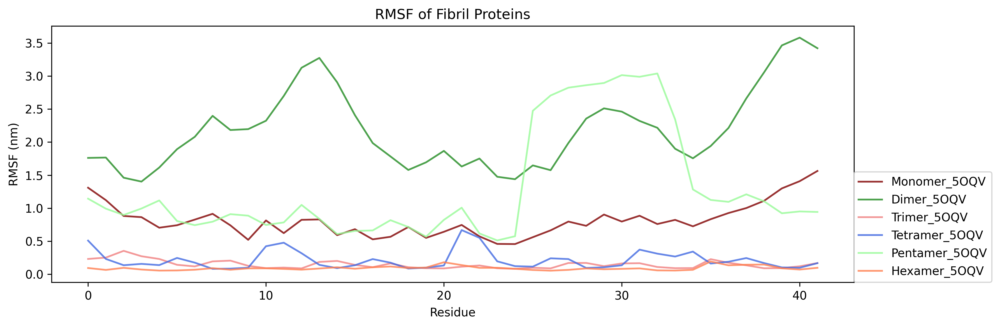

In [72]:
import matplotlib.pyplot as plt
import numpy as np

# Specify the paths to your .xvg files
file_paths = [
    'Monomer_5OQV/rmsf_res_prod_3.xvg',
    'Dimer_5OQV/rmsf_res_prod_3.xvg',
    'Trimer_5OQV/rmsf_res_prod_3.xvg',
    'Tetramer_5OQV/rmsf_res_prod_3.xvg',
    'Pentamer_5OQV/rmsf_res_prod_3.xvg',
    'Hexamer_5OQV/rmsf_res_prod_3.xvg',
]

color_lst = ['maroon', 'forestgreen', 'lightcoral', 'royalblue', 'palegreen', 'coral']

fig, ax1 = plt.subplots(figsize=(12, 4), dpi=300)

all_values = []  # List to store all values for calculating average

for path, color in zip(file_paths, color_lst):
    # Use np.loadtxt to read the file
    data = np.loadtxt(path, comments=['#', '@'])

    # Access the columns of data
    times  = data[:, 0]
    values = data[:, 1]  # Assuming the values you want are in the second column
    
    #print(values)

    # reshape the values
    reshaped_values = np.reshape(values, (int(np.max(times)),int(len(times)//np.max(times))))
    
    # take average every row 
    average_values = np.mean(reshaped_values, axis=1)


    # Extract the filename from the path
    filename = path.split('/')[0]  # Assuming the filename is the first part

    # Plot the data with a label
    ax1.plot(average_values, color=color, alpha=0.8, label=f'{filename}')

# Calculate the average)

ax1.set_xlabel('Residue')
ax1.set_ylabel('RMSF (nm)')
ax1.legend(loc=[1, 0])
ax1.set_title('RMSF of Fibril Proteins')

plt.tight_layout()
plt.show()


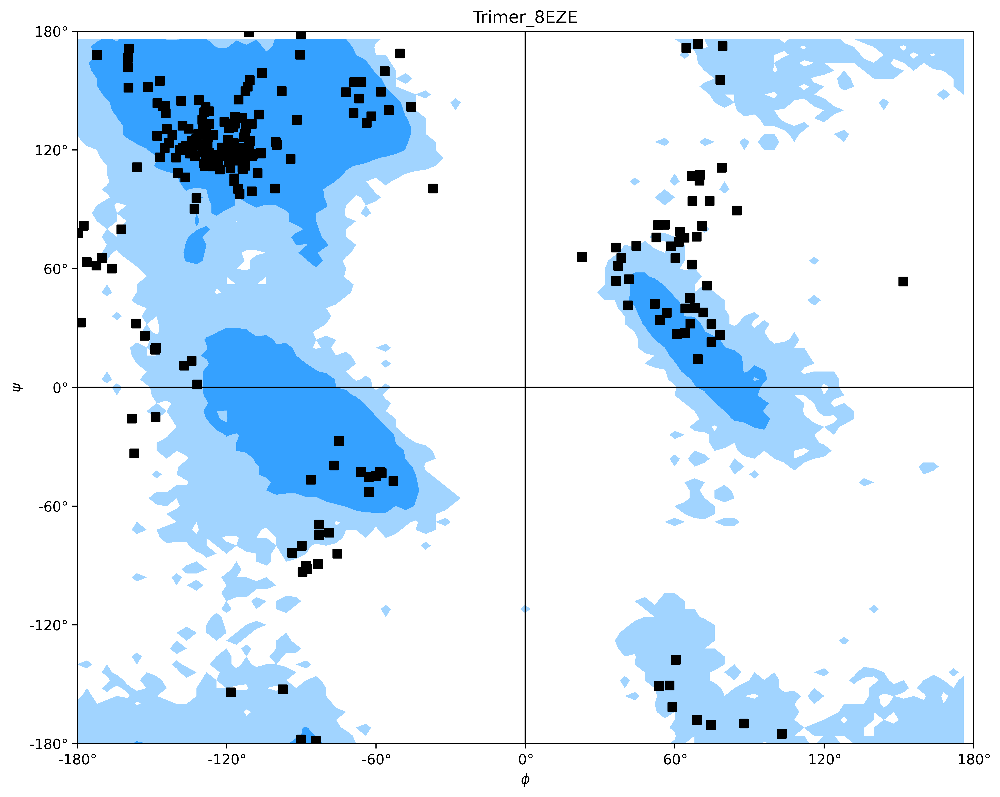

In [20]:
import MDAnalysis as mda
from MDAnalysis.analysis.dihedrals import Dihedral
import matplotlib.pyplot as plt

systems = ['Dimer_8EZD', 'Dimer_8EZE', 'Trimer_8EZD', 'Trimer_8EZE']

fig, axes = plt.subplots(1, 1, figsize=(10, 8), dpi=600)

u0 = mda.Universe('Hexamer_8EZE/md_solu.pdb', 'Hexamer_8EZE/md_solu.xtc')
#u1 = mda.Universe('Dimer_8EZE/md_solu.pdb', 'Dimer_8EZE/md_solu.xtc')
#u2 = mda.Universe('Trimer_8EZD/md_solu.pdb', 'Trimer_8EZD/md_solu.xtc')
#u3 = mda.Universe('Trimer_8EZE/md_solu.pdb', 'Trimer_8EZE/md_solu.xtc')
# Calculate Ramachandran angles
R0 = Ramachandran(u0.select_atoms('protein')).run(step=1000)
#R1 = Ramachandran(u1.select_atoms('protein')).run(step=500)
#R2 = Ramachandran(u2.select_atoms('protein')).run(step=500)
#R3 = Ramachandran(u3.select_atoms('protein')).run(step=500)
# Plot every 200th data point
R0.plot(ax=axes, color='k', marker='s', ref=True)
#R1.plot(ax=axes[0,1], color='k', marker='s', ref=True)
#R2.plot(ax=axes[1,0], color='k', marker='s', ref=True)
#R3.plot(ax=axes[1,1], color='k', marker='s', ref=True)

axes.set_title(systems[3])
#axes[0,1].set_title(systems[1])
#axes[1,0].set_title(systems[2])
#axes[1,1].set_title(systems[3])

# Adjust layout
plt.tight_layout()

# Show the plot
plt.show()


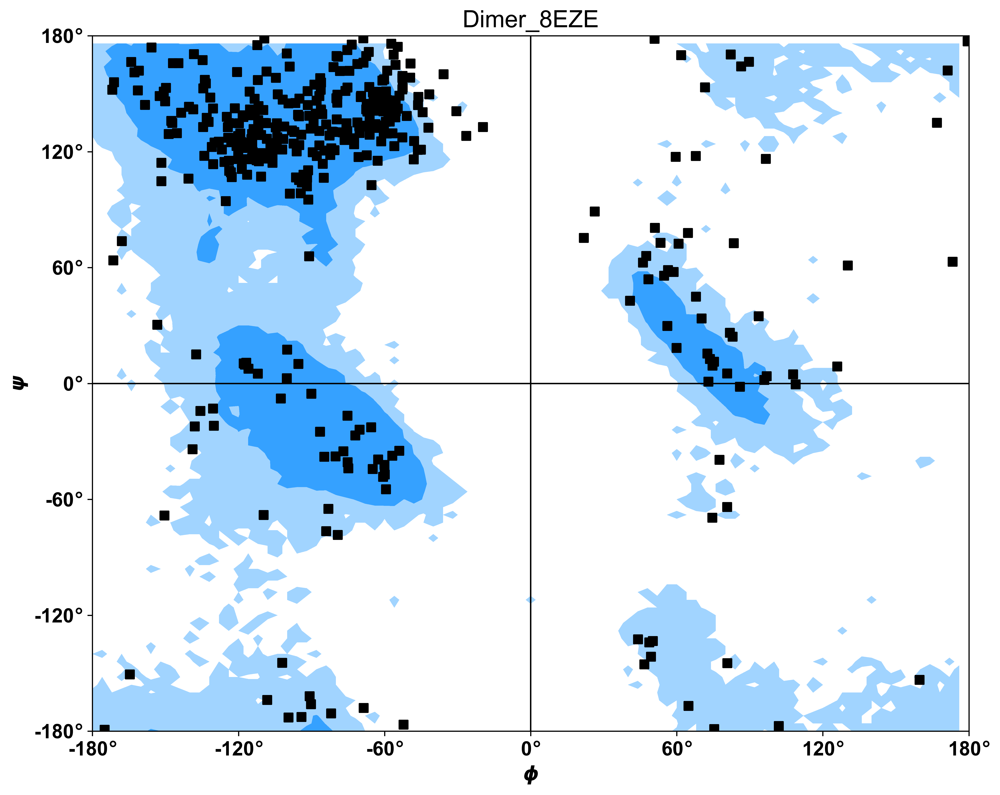

In [66]:
import MDAnalysis as mda
from MDAnalysis.analysis.dihedrals import Dihedral
import matplotlib.pyplot as plt

systems = ['Dimer_8EZD', 'Dimer_8EZE', 'Trimer_8EZD', 'Trimer_8EZE']

fig, axes = plt.subplots(1, 1, figsize=(10, 8), dpi=600)

u0 = mda.Universe('Dimer_8EZE/md_solu.pdb', 'Dimer_8EZE/md_solu.xtc')
#u1 = mda.Universe('Dimer_8EZE/md_solu.pdb', 'Dimer_8EZE/md_solu.xtc')
#u2 = mda.Universe('Trimer_8EZD/md_solu.pdb', 'Trimer_8EZD/md_solu.xtc')
#u3 = mda.Universe('Trimer_8EZE/md_solu.pdb', 'Trimer_8EZE/md_solu.xtc')
# Calculate Ramachandran angles
R0 = Ramachandran(u0.select_atoms('protein')).run(step=100)
#R1 = Ramachandran(u1.select_atoms('protein')).run(step=500)
#R2 = Ramachandran(u2.select_atoms('protein')).run(step=500)
#R3 = Ramachandran(u3.select_atoms('protein')).run(step=500)
# Plot every 200th data point
R0.plot(ax=axes, color='k', marker='s', ref=True)
#R1.plot(ax=axes[0,1], color='k', marker='s', ref=True)
#R2.plot(ax=axes[1,0], color='k', marker='s', ref=True)
#R3.plot(ax=axes[1,1], color='k', marker='s', ref=True)

axes.set_title(systems[1])
#axes[0,1].set_title(systems[1])
#axes[1,0].set_title(systems[2])
#axes[1,1].set_title(systems[3])

# Adjust layout
plt.tight_layout()

# Show the plot
plt.show()


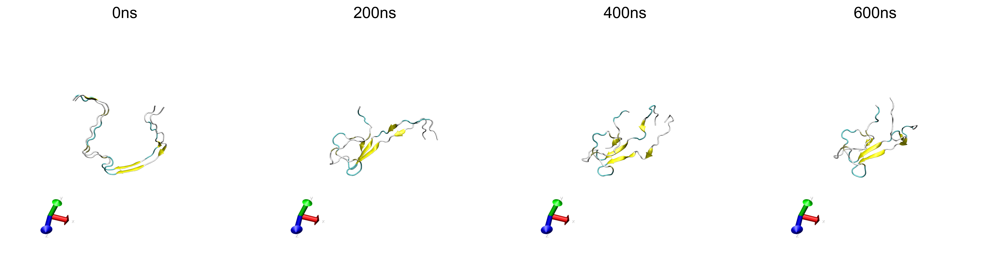

In [74]:
import matplotlib.pyplot as plt
import matplotlib.image as mpimg

fig, axes = plt.subplots(1, 4, figsize=(15, 9), dpi=600)
directory = 'visualization/Dimer_8EZE/'

# Define the extent of the zoomed-in region
zoom_extent = [0, 10, 0, 10]

for i in range(4):
    # Load and display images
    img_path = directory + f'0{i+1}.tga'
    img = mpimg.imread(img_path)
    
    # Plot the image on the corresponding subplot
    ax = axes[i]
    ax.imshow(img, extent=zoom_extent)
    ax.set_title(f'{i*200}ns')
    ax.axis('off')  # Turn off axis labels

# Set the title for the entire figure
#fig.suptitle(directory.split('/')[-2])

# Adjust layout
plt.tight_layout()

# Show the plot
plt.show()


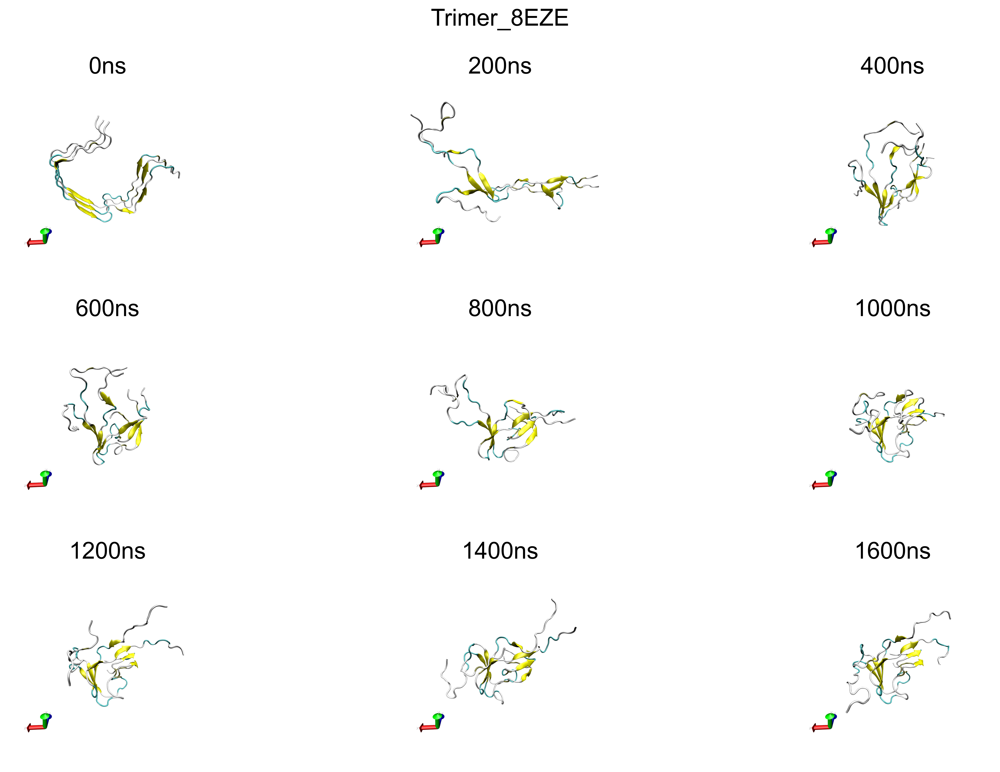

In [85]:
import matplotlib.pyplot as plt
import matplotlib.image as mpimg

fig, axes = plt.subplots(3, 3, figsize=(15, 9), dpi=600)
directory = 'visualization/Trimer_8EZE/'

for i in range(9):
    # Load and display images
    img_path = directory + f'test{i}.tga'
    img = mpimg.imread(img_path)
    
    # Plot the image on the corresponding subplot
    ax = axes[i // 3, i % 3]
    ax.imshow(img)
    ax.set_title(f'{i*200}ns')
    ax.axis('off')  # Turn off axis labels

# Set the title for the entire figure
fig.suptitle(directory.split('/')[-2])

# Adjust layout
plt.tight_layout()

# Show the plot
plt.show()


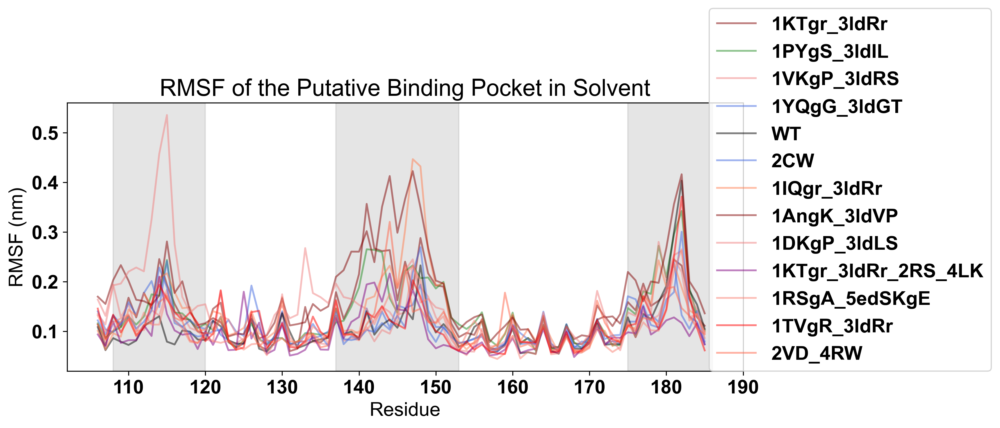

In [21]:


# Set font size, family, and weight
plt.rcParams.update({'font.size': 16, 'font.family': 'sans-serif', 'font.sans-serif': 'Arial', 'font.weight': 'bold'})

# Specify the paths to your .xvg files
file_paths = [
        '1KTgr_3ldRr/rmsf_res_prod_3.xvg',
        '1PYgS_3ldIL/rmsf_res_prod_3.xvg',
        '1VKgP_3ldRS/rmsf_res_prod_3.xvg',
        '1YQgG_3ldGT/rmsf_res_prod_3.xvg',
                 'WT/rmsf_res_prod_3.xvg',
                '2CW/rmsf_res_prod_3.xvg',
        '1IQgr_3ldRr/rmsf_res_prod_3.xvg',
        '1AngK_3ldVP/rmsf_res_prod_3.xvg',
        '1DKgP_3ldLS/rmsf_res_prod_3.xvg',
'1KTgr_3ldRr_2RS_4LK/rmsf_res_prod_3.xvg',
      '1RSgA_5edSKgE/rmsf_res_prod_3.xvg',
        '1TVgR_3ldRr/rmsf_res_prod_3.xvg',
            '2VD_4RW/rmsf_res_prod_3.xvg',
]

color_lst = ['maroon', 'forestgreen', 'lightcoral', 'royalblue', 'black', 'royalblue', 'coral','maroon','lightcoral', 'purple', 'salmon', 'red', 'tomato']


fig, ax1 = plt.subplots(figsize=(10, 4), dpi=300)

for i, path in enumerate(file_paths):
    # Use np.loadtxt to read the file
    data = np.loadtxt(path, comments=['#', '@'])

    # Access the columns of data
    time = data[:, 0]  # Assuming time is in the first column
    values = data[:, 1]  # Assuming the values you want are in the second column

    # Extract the filename from the path
    filename = path.split('/')[-2]  # Assuming the filename is the second-to-last part

    # Plot the data with a label
    ax1.plot(time[65:145], values[65:145], color=color_lst[i], label=filename, alpha=0.5)

ax1.set_xlabel('Residue')
ax1.set_ylabel('RMSF (nm)')
ax1.axvspan(108, 120, color='grey', alpha=0.2)
ax1.axvspan(137, 153, color='grey', alpha=0.2)
ax1.axvspan(175, 186, color='grey', alpha=0.2)
#ax1.text(132, 0.3, 'Mutation Pockets', ha='center', va='center')
ax1.legend(loc=[0.95,0])
ax1.set_title('RMSF of the Putative Binding Pocket in Solvent')

# Save the figure with a transparent background
#fig.savefig("your_output_file.png", transparent=True)

plt.show()


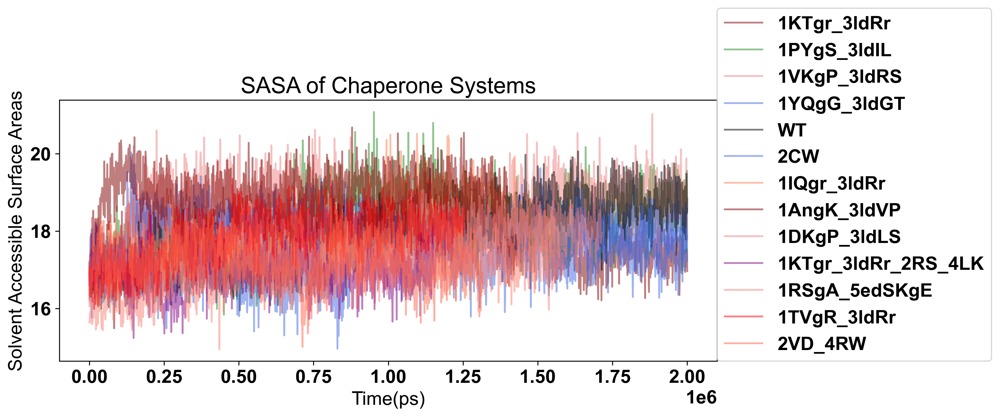

In [195]:

color_lst = ['maroon','forestgreen', 'lightcoral', 'royalblue', 'black']

# Specify the paths to your .xvg files
file_paths = [
        '1KTgr_3ldRr/sasa_lib5.xvg',
        '1PYgS_3ldIL/sasa_lib5.xvg',
        '1VKgP_3ldRS/sasa_lib5.xvg',
        '1YQgG_3ldGT/sasa_lib5.xvg',
                 'WT/sasa_lib5.xvg',
                '2CW/sasa_lib5.xvg',
        '1IQgr_3ldRr/sasa_lib5.xvg',
        '1AngK_3ldVP/sasa_lib5.xvg',
        '1DKgP_3ldLS/sasa_lib5.xvg',
'1KTgr_3ldRr_2RS_4LK/sasa_lib5.xvg',
      '1RSgA_5edSKgE/sasa_lib5.xvg',
        '1TVgR_3ldRr/sasa_lib5.xvg',
            '2VD_4RW/sasa_lib5.xvg',
]

color_lst = ['maroon', 'forestgreen', 'lightcoral', 'royalblue', 'black', 'royalblue', 'coral','maroon','lightcoral', 'purple', 'salmon', 'red', 'tomato']
fig, ax1 = plt.subplots(figsize=(10, 4), dpi=300)

for i, path in enumerate(file_paths):  # Use enumerate to track the current index
    # Use np.loadtxt to read the file
    data = np.loadtxt(path, comments=['#', '@'])
    
    # Access the columns of data
    time = data[:, 0]  # Assuming time is in the first column
    values = data[:, 1]  # Assuming the values you want are in the second column
    
    # Extract the filename from the path
    filename = path.split('/')[-2]  # Assuming the filename is the second-to-last part
    
    # Plot the data with a specified line color and label
    ax1.plot(time, values, color=color_lst[i], label=filename, alpha = 0.5)

ax1.set_xlabel('Time(ps)')
ax1.set_ylabel('Solvent Accessible Surface Areas')
ax1.legend(loc=[1.0, 0])
ax1.set_title('SASA of Chaperone Systems')
plt.show()


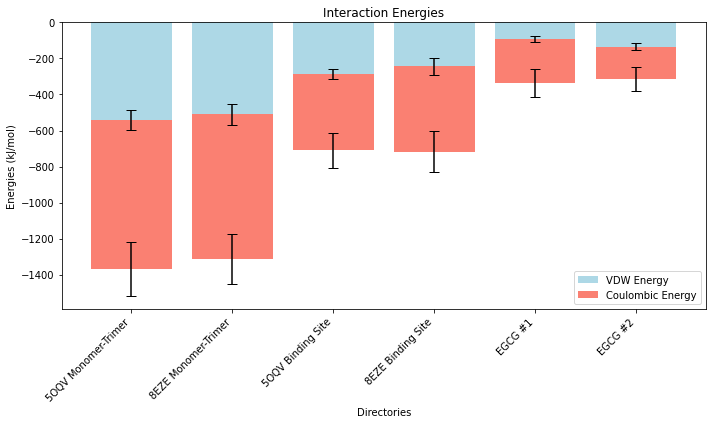

In [2]:
import os
import numpy as np
import matplotlib.pyplot as plt

color_lst = ['maroon', 'forestgreen', 'lightcoral', 'royalblue', 'black', 'royalblue', 'coral', 'maroon', 'lightcoral', 'purple', 'coral', 'red', 'coral', 'darkred']

directories = [
    "Tetramer_5OQV",
    "Tetramer_8EZE/",
    "Partial_5OQV_Tetra/",
    "Partial_8EZE_Tetra/",
    "../../Ab42/EGCG_drug_Dock/E5_4_S_0",
    "../../Ab42/EGCG_drug_Dock/E5_7_S_10", 
]

# Initialize empty lists to store means and stds for energy_1 and energy_2
mean_energy_1 = []
std_energy_1 = []
mean_energy_2 = []
std_energy_2 = []

# Loop through directories
for directory in directories:
    xvg_file = os.path.join(directory, 'energy_groups.xvg')
    # Load data from the XVG file
    data = np.loadtxt(xvg_file, comments=['#', '@'])
    # Calculate mean and standard deviation for each energy group
    mean_energy_1.append(np.mean(data[:, 2]))
    std_energy_1.append(np.std(data[:, 2]))
    mean_energy_2.append(np.mean(data[:, 1]))
    std_energy_2.append(np.std(data[:, 1]))
    
labels = ['5OQV Monomer-Trimer', '8EZE Monomer-Trimer','5OQV Binding Site',  '8EZE Binding Site','EGCG #1', 'EGCG #2']

# Plot the data with custom labels as a stacked bar plot
x_pos = np.arange(len(directories))

plt.figure(figsize=(10, 6))
plt.bar(x_pos, mean_energy_1, yerr=std_energy_1, capsize=5, color='lightblue', label='VDW Energy')
plt.bar(x_pos, mean_energy_2, yerr=std_energy_2, bottom=mean_energy_1, capsize=5, color='salmon', label='Coulombic Energy')
plt.ylabel('Energies (kJ/mol)')
plt.xlabel('Directories')
plt.title('Interaction Energies')
plt.xticks(x_pos, labels, rotation=45, ha="right")
plt.legend()
plt.tight_layout()
plt.show()


In [5]:
mean_energy_1

[-541.2037753686709,
 -510.6163871177536,
 -286.65376309810125,
 -243.30549518115942,
 -92.49146576190478,
 -134.1506670952381]

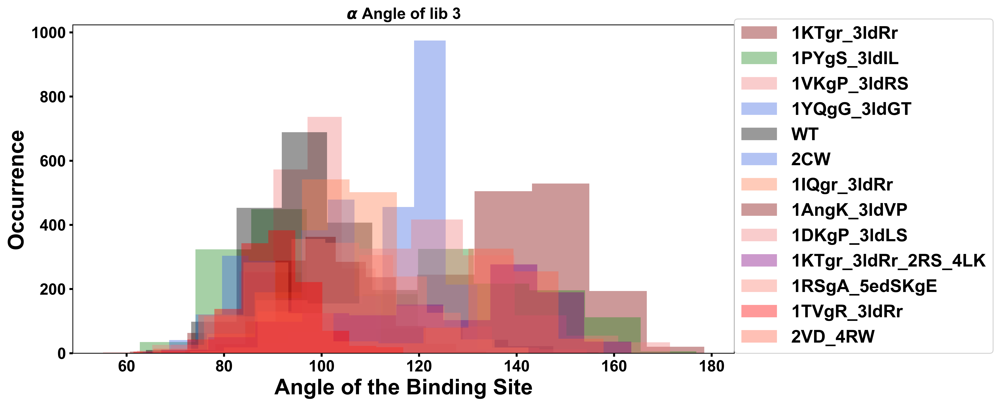

In [184]:
import numpy as np
import matplotlib.pyplot as plt
plt.rcParams.update({'font.size': 16, 'font.family': 'sans-serif', 'font.sans-serif': 'Arial', 'font.weight': 'bold'})

def load_data(directory, file_prefix, num_files):
    values = []
    file_path = f'{directory}/{file_prefix}.xvg'
    data = np.loadtxt(file_path, comments=['#', '@'])
    values.append(data[:, 1])
    return values



directories = ['1KTgr_3ldRr', '1PYgS_3ldIL', '1VKgP_3ldRS',   '1YQgG_3ldGT',  'WT',  '2CW', '1IQgr_3ldRr','1AngK_3ldVP', '1DKgP_3ldLS','1KTgr_3ldRr_2RS_4LK','1RSgA_5edSKgE', '1TVgR_3ldRr','2VD_4RW']

colors = ['maroon', 'forestgreen', 'lightcoral', 'royalblue', 'black', 'royalblue', 'coral','maroon','lightcoral', 'purple', 'salmon', 'red', 'tomato']
labels = ['1KTgr_3ldRr', '1PYgS_3ldIL', '1VKgP_3ldRS',   '1YQgG_3ldGT',  'WT',  '2CW', '1IQgr_3ldRr','1AngK_3ldVP', '1DKgP_3ldLS','1KTgr_3ldRr_2RS_4LK','1RSgA_5edSKgE', '1TVgR_3ldRr','2VD_4RW']
file_prefixes = ['angle2'] * 13
num_files_per_directory = 1

# Set figure size and DPI
fig, ax1 = plt.subplots(figsize=(12, 6), dpi=500)

# Specify colors using the existing line
#colors = ['#800000', '#228B22', '#F08080', '#4169E1', '#000000']  # maroon, forestgreen, lightcoral, royalblue, black


for dir, prefix, color, label in zip(directories, file_prefixes, colors, labels):
    values = load_data(dir, prefix, num_files_per_directory)
    for v in values:
        ax1.hist(v, color=color, label=label, alpha=0.4)
ax1.set_title(r'$\alpha$ Angle of lib 3', fontsize=16, fontweight='bold', color='#000000')  # Bold font and very black color
ax1.set_xlabel('Angle of the Binding Site', fontsize=22, fontweight='bold', color='#000000')  # Bold font and very black color
ax1.set_ylabel('Occurrence', fontsize=22, fontweight='bold', color='#000000')  # Bold font and very black color

# Create the legend with bold text
ax1.legend(loc=[1,0], fontsize=18)


# Set tick labels to be bold and very black
ax1.tick_params(axis='both', labelsize=16, colors='#000000', width=2)

# Save the figure with a transparent background
#plt.savefig('output_figure.png', dpi=500, transparent=True)

plt.show()


In [ ]:

def load_data(directory, file_prefix, num_files):
    values = []
    times = []
    for i in range(1, num_files + 1):
        file_path = f'{directory}/{file_prefix}{i}.xvg'
        data = np.loadtxt(file_path, comments=['#', '@'])
        values.append(data[:, 1])
        times.append(data[:, 0])
    return times, values


directories = ['1KTgr_3ldRr', '1PYgS_3ldIL', '1VKgP_3ldRS',   '1YQgG_3ldGT',  'WT',  '2CW', '1IQgr_3ldRr','1AngK_3ldVP', '1DKgP_3ldLS','1KTgr_3ldRr_2RS_4LK','1RSgA_5edSKgE', '1TVgR_3ldRr','2VD_4RW']

colors = ['maroon', 'forestgreen', 'lightcoral', 'royalblue', 'black', 'royalblue', 'coral','maroon','lightcoral', 'purple', 'salmon', 'red', 'tomato']
labels = ['1KTgr_3ldRr', '1PYgS_3ldIL', '1VKgP_3ldRS',   '1YQgG_3ldGT',  'WT',  '2CW', '1IQgr_3ldRr','1AngK_3ldVP', '1DKgP_3ldLS','1KTgr_3ldRr_2RS_4LK','1RSgA_5edSKgE', '1TVgR_3ldRr','2VD_4RW']
file_prefixes = ['plane']*13
num_files_per_directory = 3

fig, ax1 = plt.subplots(figsize=(10, 4), dpi=300)


for dir, prefix, color, label in zip(directories, file_prefixes, colors, labels):
    times, values = load_data(dir, prefix, num_files_per_directory)
    for v in values:
        ax1.plot(v, color=color, label=label, alpha=0.4)

ax1.set_xlabel('Angle of the Binding Site ')
ax1.set_ylabel('Occurance')
ax1.legend(loc=[1, 0])
plt.show()


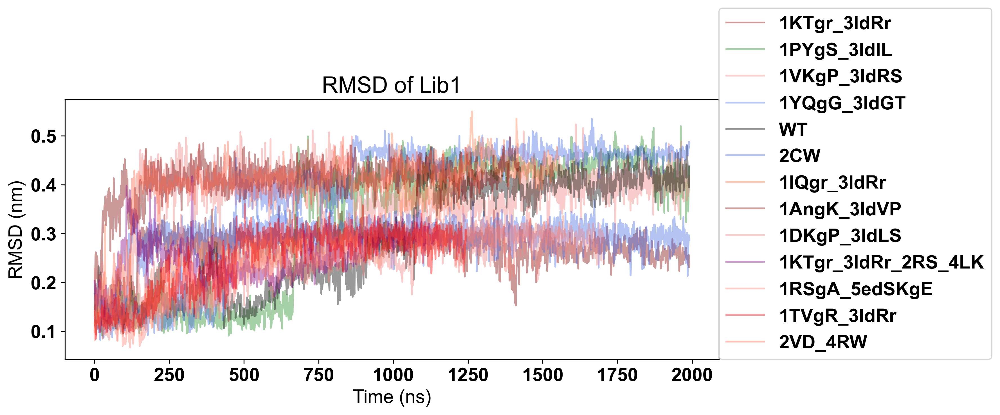

In [192]:

# Specify the paths to your .xvg files
file_paths = [
        '1KTgr_3ldRr/rmsd_lib5.xvg',
        '1PYgS_3ldIL/rmsd_lib5.xvg',
        '1VKgP_3ldRS/rmsd_lib5.xvg',
        '1YQgG_3ldGT/rmsd_lib5.xvg',
                 'WT/rmsd_lib5.xvg',
                '2CW/rmsd_lib5.xvg',
        '1IQgr_3ldRr/rmsd_lib5.xvg',
        '1AngK_3ldVP/rmsd_lib5.xvg',
        '1DKgP_3ldLS/rmsd_lib5.xvg',
'1KTgr_3ldRr_2RS_4LK/rmsd_lib5.xvg',
      '1RSgA_5edSKgE/rmsd_lib5.xvg',
        '1TVgR_3ldRr/rmsd_lib5.xvg',
            '2VD_4RW/rmsd_lib5.xvg',
]

color_lst = ['maroon', 'forestgreen', 'lightcoral', 'royalblue', 'black', 'royalblue', 'coral','maroon','lightcoral', 'purple', 'salmon', 'red', 'tomato']
fig, ax1 = plt.subplots(figsize=(10, 4), dpi=300)


for i in range(len(file_paths)):
    # Use np.loadtxt to read the file
    data = np.loadtxt(file_paths[i], comments=['#', '@'])
    
    # Access the columns of data
    time = data[10:, 0]  # Assuming time is in the first column
    values = data[10:, 1]  # Assuming the values you want are in the second column
    
    # Extract the filename from the path
    filename = file_paths[i].split('/')[-2]  # Assuming the filename is the second-to-last part
    
    # Plot the data with a label
    ax1.plot(values, label=filename, color = color_lst[i],alpha = 0.4)

ax1.set_xlabel('Time (ns)')
ax1.set_ylabel('RMSD (nm)')
#ax1.axvspan(114, 116, color='grey', alpha=0.2)
#ax1.axvspan(146, 148, color='grey', alpha=0.2)
#ax1.text(132, 0.3, 'Mutation Pockets', ha='center', va='center', fontsize = 'large')
ax1.legend(loc=[1.0,0])
ax1.set_title('RMSD of Lib1')
plt.show()


In [8]:
from __future__ import print_function
%matplotlib inline
import mdtraj as md
import matplotlib.pyplot as plt
from sklearn.decomposition import PCA


(2001, 2)


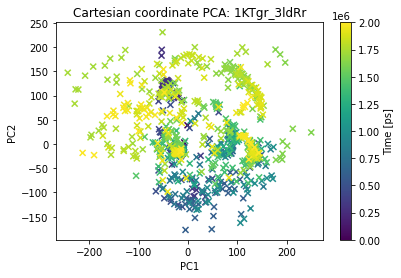

In [9]:

directory = 'Pentamer_8EZE'
traj = md.load(directory+'/md_solu.xtc', top=directory+'/md_solu.pdb')

pca1 = PCA(n_components=2)
traj.superpose(traj, 0)
reduced_cartesian = pca1.fit_transform(traj.xyz.reshape(traj.n_frames, traj.n_atoms * 3))
print(reduced_cartesian.shape)
plt.figure()
plt.scatter(reduced_cartesian[:, 0], reduced_cartesian[:,1], marker='x', c=traj.time)
plt.xlabel('PC1')
plt.ylabel('PC2')
plt.title('Cartesian coordinate PCA: 1KTgr_3ldRr')
cbar = plt.colorbar()
cbar.set_label('Time [ps]')

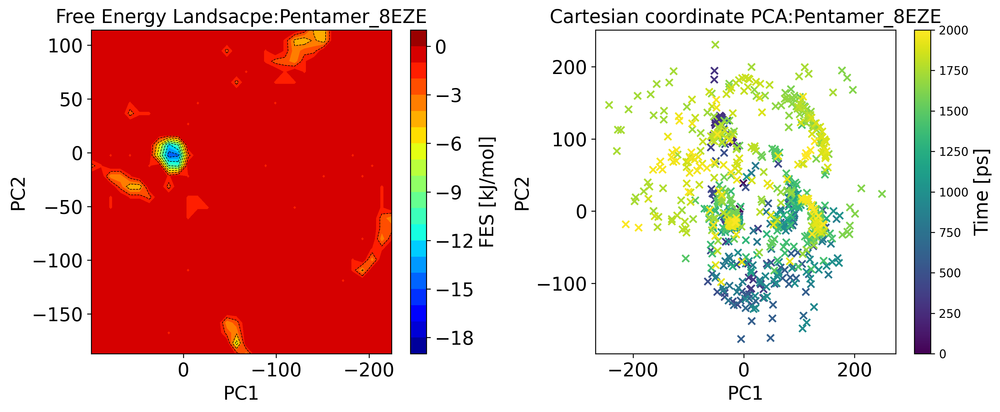

In [12]:
import numpy as np
import matplotlib.pyplot as plt
import matplotlib.cm as cm

# Load data

data = np.genfromtxt(directory+'/gibbs.txt')

# Reshape data for contour plot
dist_A = np.array(data[:, 0]).reshape(32, 32)
dist_B = np.array(data[:, 1]).reshape(32, 32)
fes = np.array(data[:, 2]).reshape(32, 32)
fes_max = np.max(fes)
fes = fes - fes_max

# Plot
fig, (ax1, ax2) = plt.subplots(nrows=1, ncols=2, figsize=(12, 5), dpi=300)

# Contour plot
contour = ax1.contour(dist_A, dist_B, fes, linewidths=0.5, colors='k')
cntr = ax1.contourf(dist_A, dist_B, fes, levels=range(-19, 2), cmap=cm.jet)
cbar1 = fig.colorbar(cntr, ax=ax1, label="FES [kJ/mol]")
cbar1.ax.set_ylabel('FES [kJ/mol]', fontsize=16)
cbar1.ax.tick_params(labelsize=16) 
ax1.set_xlabel("PC1", fontsize=16)
ax1.set_ylabel("PC2", fontsize=16)
ax1.set_title('Free Energy Landsacpe:'+directory, fontsize=16)
ax1.invert_xaxis()
#ax1.invert_yaxis()

# Scatter plot
sc = ax2.scatter(reduced_cartesian[:, 0], reduced_cartesian[:, 1], marker='x', c=np.arange(len(reduced_cartesian)))
ax2.set_xlabel('PC1', fontsize=16)
ax2.set_ylabel('PC2', fontsize=16)
ax2.set_title('Cartesian coordinate PCA:'+directory, fontsize=16)
cbar = fig.colorbar(sc, ax=ax2)
cbar1.ax.tick_params(labelsize=16) 
cbar.set_label('Time [ps]', fontsize=16)

# Set all tick labels font size
for ax in [ax1, ax2]:
    ax.tick_params(axis='both', which='major', labelsize=16)
    ax.tick_params(axis='both', which='minor', labelsize=16)
    ax.xaxis.label.set_size(16)
    ax.yaxis.label.set_size(16)

plt.tight_layout()
plt.show()


# mdtraj and measure distance 

In [196]:
import mdtraj as md

In [104]:
#traj0  = md.load('../1KTgr_3ldRr/md_solu.xtc', top='../1KTgr_3ldRr/md_solu.pdb')
traj0  = md.load('Trimer_8EZE/md_solu.xtc', top='Trimer_8EZE/md_solu.pdb')


pca1 = PCA(n_components=2)
traj0.superpose(traj0, 0)


<mdtraj.Trajectory with 980 frames, 1881 atoms, 126 residues, and unitcells at 0x7f5384ad4a90>

In [105]:
#traj0  = md.load('../1KTgr_3ldRr/md_solu.xtc', top='../1KTgr_3ldRr/md_solu.pdb')
traj0  = md.load('Trimer_8EZE/md_solu.xtc', top='Trimer_8EZE/md_solu.pdb')


pca1 = PCA(n_components=2)
traj0.superpose(traj0, 0)

reduced_cartesian = pca1.fit_transform(traj0.xyz.reshape(traj0.n_frames, traj0.n_atoms * 3))
print(reduced_cartesian.shape)

(980, 2)


(710, 2)


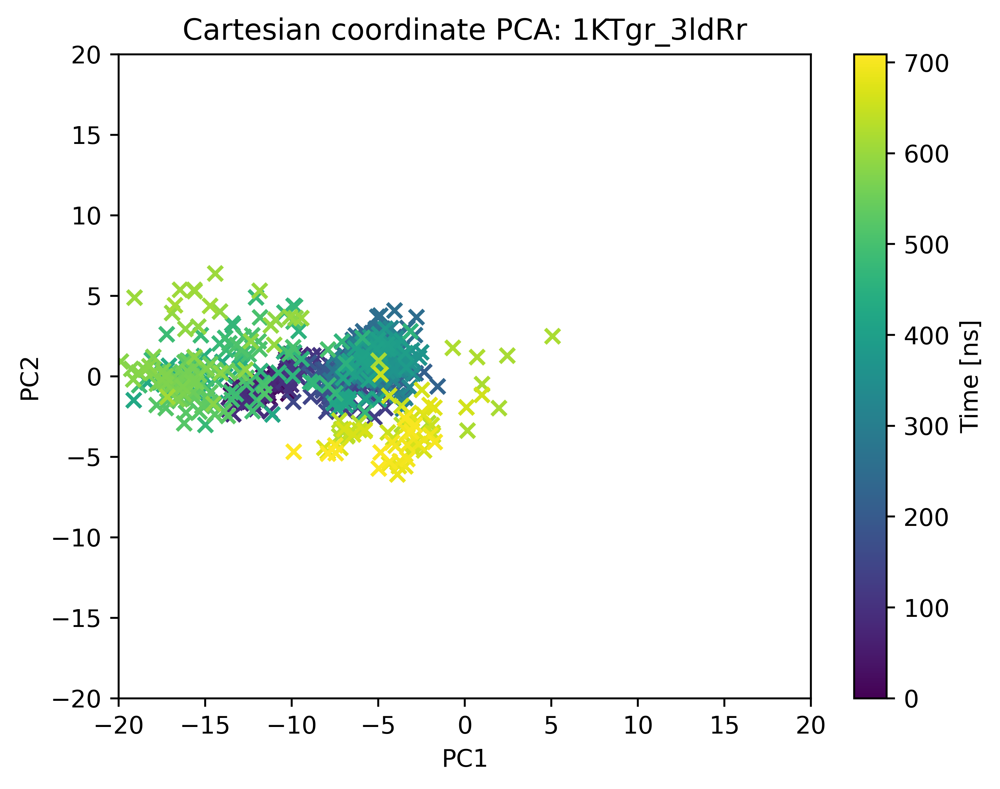

In [197]:
#traj0  = md.load('../1KTgr_3ldRr/md_solu.xtc', top='../1KTgr_3ldRr/md_solu.pdb')
traj0  = md.load('Trimer_5OQV/md_solu.xtc', top='Trimer_5OQV/md_solu.pdb')


pca1 = PCA(n_components=2)
traj0.superpose(traj0, 0)

reduced_cartesian = pca1.fit_transform(traj0.xyz.reshape(traj0.n_frames, traj0.n_atoms * 3))
print(reduced_cartesian.shape)
plt.figure(dpi=500)
plt.scatter(reduced_cartesian[:, 0], reduced_cartesian[:,1], marker='x', c=np.array(traj0.time[:])/1000)
plt.xlabel('PC1')
plt.ylabel('PC2')
plt.xlim([-20, 20])
plt.ylim([-20, 20])
plt.title('Cartesian coordinate PCA: 1KTgr_3ldRr')
cbar = plt.colorbar()
cbar.set_label('Time [ns]')

In [2]:
traj0  = md.load('1KTgr_3ldRr/md_solu.xtc', top='1KTgr_3ldRr/md_solu.pdb')
traj1  = md.load('1VKgP_3ldRS/md_solu.xtc', top='1VKgP_3ldRS/md_solu.pdb')
traj2  = md.load('1YQgG_3ldGT/md_solu.xtc', top='1YQgG_3ldGT/md_solu.pdb')
traj3  = md.load('1PYgS_3ldIL/md_solu.xtc', top='1PYgS_3ldIL/md_solu.pdb')
traj4  = md.load('WT/md_solu.xtc', top='WT/md_solu.pdb')
traj5  = md.load('2CW/md_solu.xtc', top='2CW/md_solu.pdb')
traj6  = md.load('1IQgr_3ldRr/md_solu.xtc', top='1IQgr_3ldRr/md_solu.pdb')
traj7  = md.load('1AngK_3ldVP/md_solu.xtc', top='1AngK_3ldVP/md_solu.pdb')
traj8  = md.load('1DKgP_3ldLS/md_solu.xtc', top='1DKgP_3ldLS/md_solu.pdb')
traj9  = md.load('1KTgr_3ldRr_2RS_4LK/md_solu.xtc', top='1KTgr_3ldRr_2RS_4LK/md_solu.pdb')
traj10 = md.load('1RSgA_5edSKgE/md_solu.xtc', top='1RSgA_5edSKgE/md_solu.pdb')
traj11 = md.load('1TVgR_3ldRr/md_solu.xtc', top='1TVgR_3ldRr/md_solu.pdb')
traj12 = md.load('2VD_4RW/md_solu.xtc', top='2VD_4RW/md_solu.pdb')

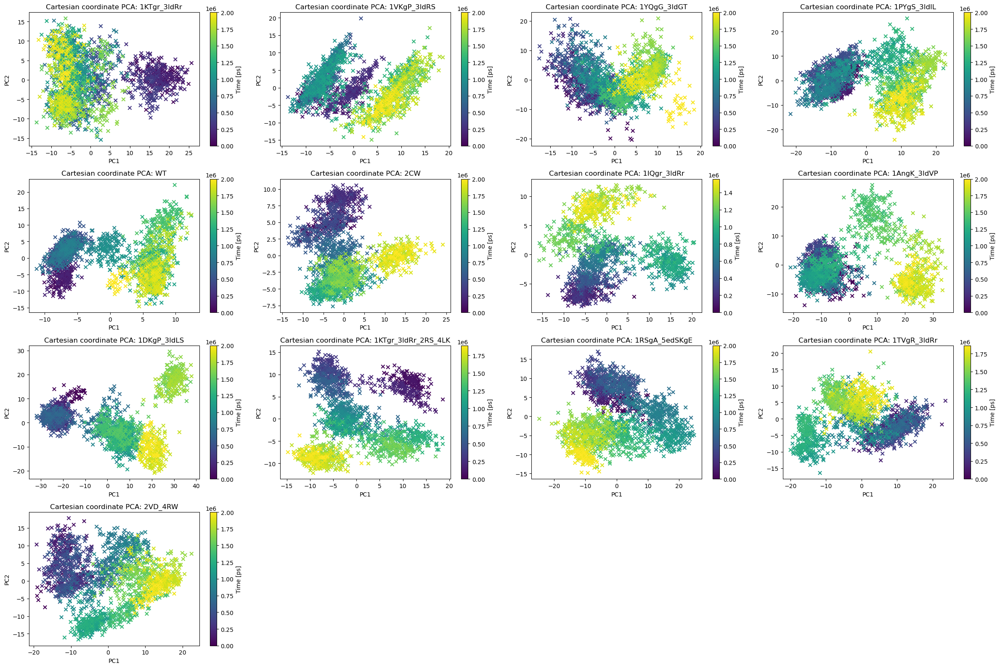

In [4]:
from sklearn.cluster import KMeans
common_xlim = (-25, 30)
common_ylim = (-20, 20)
plt.rcdefaults()
# Initialize PCA
pca = PCA(n_components=2)

red_cartesian_values = []
cluster_labels = []

times_lst = [traj0.time, traj1.time, traj2.time, traj3.time, traj4.time, traj5.time, traj6.time,traj7.time, traj8.time, traj9.time, traj10.time, traj11.time, traj12.time]
labels = ['1KTgr_3ldRr', '1VKgP_3ldRS',  '1YQgG_3ldGT','1PYgS_3ldIL', 'WT', '2CW', '1IQgr_3ldRr', '1AngK_3ldVP', '1DKgP_3ldLS','1KTgr_3ldRr_2RS_4LK', '1RSgA_5edSKgE', '1TVgR_3ldRr', '2VD_4RW']
color_lst = ['maroon', 'forestgreen', 'lightcoral', 'royalblue', 'black', 'royalblue', 'coral','maroon','lightcoral', 'purple', 'salmon', 'red', 'tomato']

for traj in [traj0, traj1, traj2, traj3, traj4, traj5, traj6, traj7, traj8, traj9, traj10, traj11, traj12 ]:
    traj.superpose(traj, 0)  # Superpose each trajectory to its first frame
    reduced_cartesian = pca.fit_transform(traj.xyz.reshape(traj.n_frames, traj.n_atoms * 3))

    # Store the PC1 and PC2 values
    red_cartesian_values.append(reduced_cartesian)
    kmeans = KMeans(n_clusters=3)  # Change the number of clusters as needed
    labels_1 = kmeans.fit_predict(reduced_cartesian)
    
    # Store the PC1 and PC2 values and cluster labels
    cluster_labels.append(labels_1)

# Create a 3x2 grid of subplots with improved spacing
fig, axes = plt.subplots(4, 4, figsize=(24, 16))

# Manually set the last subplot not to be visible
axes[-1, -1].axis('off')
axes[-1, -2].axis('off')
axes[-1, -3].axis('off')
#axes[-1, -2].axis('off')

for i, ax in enumerate(axes.flat):
    if i < len(red_cartesian_values):
        pcs = red_cartesian_values[i]

        im = ax.scatter(pcs[:, 0], pcs[:, 1], marker='x', c=times_lst[i])
        ax.set_xlabel(f'PC1 ({pca.explained_variance_ratio_[0]*100:.2f}%)')
        ax.set_ylabel('PC2')
        #ax.set_ylim(common_ylim)
        #ax.set_xlim(common_xlim)
        ax.set_title('Cartesian coordinate PCA: ' + labels[i])
        cbar = plt.colorbar(im, ax=ax)
        cbar.set_label('Time [ps]')
plt.tight_layout()
plt.show()

In [5]:
reduced_cartesian

array([[-4.3369255,  1.2275481],
       [-6.95136  ,  3.403776 ],
       [-5.3567147,  5.866628 ],
       ...,
       [17.579145 , -1.286588 ],
       [13.460427 , -1.2439529],
       [12.48909  , -5.127163 ]], dtype=float32)

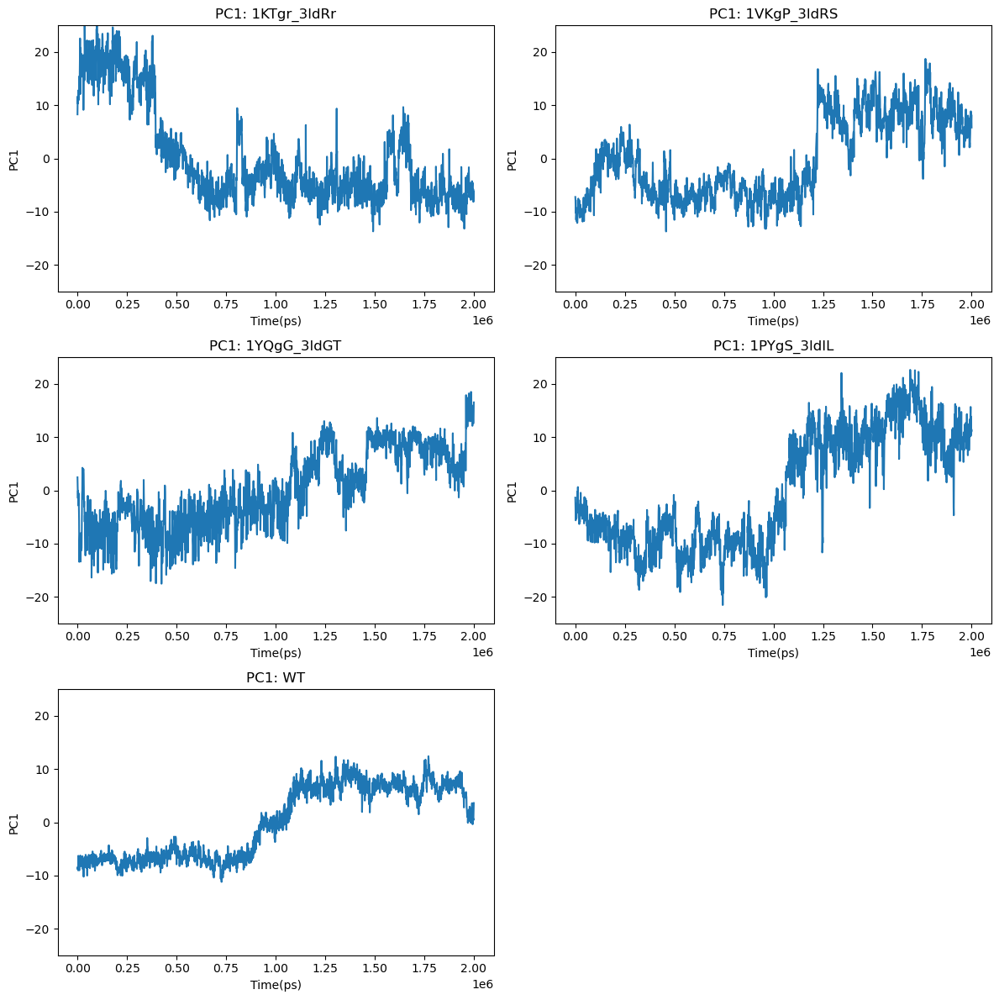

In [351]:
reduced_cartesianr_3ldRr', '1VKgP_3ldRS', '1YQgG_3ldGT', '1PYgS_3ldIL', 'WT']

# Initialize PCA
pca = PCA(n_components=2)


times_lst = [traj0.time, traj1.time, traj2.time, traj3.time, traj4.time]

# Create an empty list to store the PC1 values and times for each trajectory
pc1_values = []
times = []

# Loop through each trajectory (assuming you have traj0, traj1, traj2, etc.)
for traj in [traj0, traj1, traj2, traj3, traj4]:
    traj.superpose(traj, 0)  # Superpose each trajectory to its first frame
    reduced_cartesian = pca.fit_transform(traj.xyz.reshape(traj.n_frames, traj.n_atoms * 3))

    # Store the PC1 values and corresponding times
    pc1_values.append(reduced_cartesian[:, 0])

# Create a 3x2 grid of subplots with improved spacing
fig, axes = plt.subplots(3, 2, figsize=(12, 12))

# Manually set the last subplot not to be visible
axes[-1, -1].axis('off')

for i, ax in enumerate(axes.flat):
    if i < len(red_cartesian_values):
        im = ax.plot(times_lst[i], pc1_values[i], label = labels[i])
        ax.set_xlabel('Time(ps)')
        ax.set_ylabel('PC1')
        ax.set_title('PC1: ' + labels[i])
        ax.set_ylim([-25, 25])

plt.tight_layout()
plt.show()


In [69]:
# Specify the PDB files
pdb_files = [
        '1KTgr_3ldRr/md_final.pdb',
        '1PYgS_3ldIL/md_final.pdb',
        '1VKgP_3ldRS/md_final.pdb',
        '1YQgG_3ldGT/md_final.pdb',
                 'WT/md_final.pdb',
                '2CW/md_final.pdb',
        '1IQgr_3ldRr/md_final.pdb',
        '1AngK_3ldVP/md_final.pdb',
        '1DKgP_3ldLS/md_final.pdb',
'1KTgr_3ldRr_2RS_4LK/md_final.pdb',
      '1RSgA_5edSKgE/md_final.pdb',
        '1TVgR_3ldRr/md_final.pdb',
            '2VD_4RW/md_final.pdb',
]

# Create an empty list to store the DataFrames
pdb_dfs = []

# Read PDB files as DataFrames
for pdb_file in pdb_files:
    pdb_df = read_pdb_as_dataframe(pdb_file)
    pdb_dfs.append(pdb_df)

# Define the residue and atom names
residue_atom_info = [
    (144, 'NE2', 'serial'),
    (113, 'OD2', 'serial'),   
]

# Loop through the PDB DataFrames and residue/atom info
print('[DNA and DNA Binding]')
for pdb_df in pdb_dfs:
    for residue_number, atom_name, column_name in residue_atom_info:
        num = pdb_df[(pdb_df['residue_number'] == residue_number) & (pdb_df['name'] == atom_name)][column_name].tolist()[0]
        print(num, end=',')
    print()

[DNA and DNA Binding]
1562,1110,
1548,1110,
1554,1110,
1547,1110,
1555,1110,
1564,1110,
1562,1110,
1548,1110,
1550,1110,
1588,1110,
1547,1110,
1556,1110,
1557,1110,


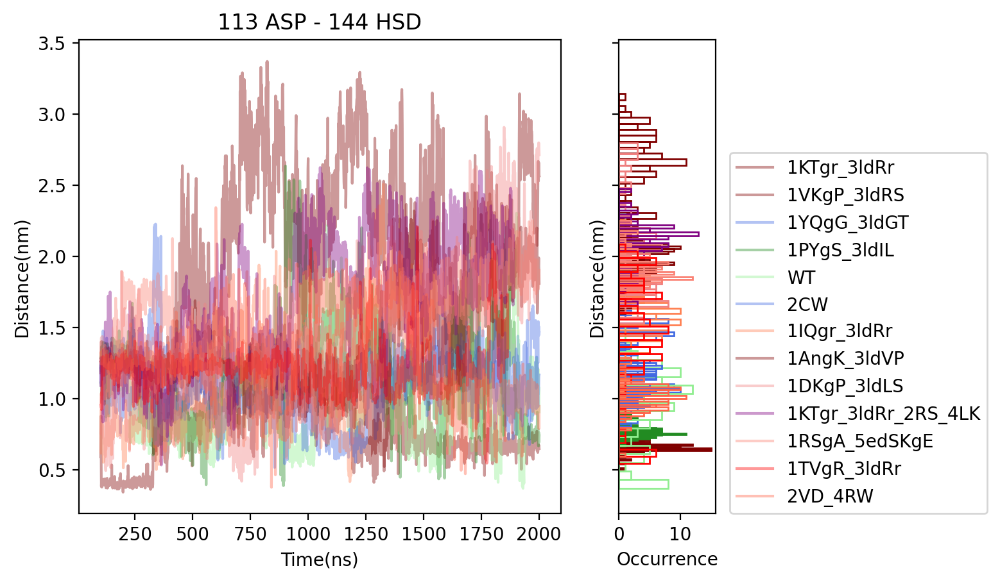

In [71]:


light_color_palette = ['maroon', 'lightcoral', 'royalblue', 'forestgreen','black']
labels = ['1KTgr_3ldRr', '1VKgP_3ldRS',  '1YQgG_3ldGT','1PYgS_3ldIL', 'WT', '2CW', '1IQgr_3ldRr', '1AngK_3ldVP', '1DKgP_3ldLS','1KTgr_3ldRr_2RS_4LK', '1RSgA_5edSKgE', '1TVgR_3ldRr', '2VD_4RW']
color_lst = ['maroon', 'maroon','royalblue','forestgreen', 'lightgreen', 'royalblue',  'coral','maroon','lightcoral', 'purple', 'salmon', 'red', 'tomato']

pairs = [
    np.array([[1562,1110,]], dtype=np.int32),
    np.array([[1548,1110,]], dtype=np.int32),
    np.array([[1554,1110,]], dtype=np.int32),
    np.array([[1547,1110,]], dtype=np.int32),
    np.array([[1555,1110,]], dtype=np.int32),
    np.array([[1564,1110,]], dtype=np.int32),
    np.array([[1562,1110,]], dtype=np.int32),
    np.array([[1548,1110,]], dtype=np.int32),
    np.array([[1550,1110,]], dtype=np.int32),
    np.array([[1588,1110,]], dtype=np.int32),
    np.array([[1547,1110,]], dtype=np.int32),
    np.array([[1556,1110,]], dtype=np.int32),
    np.array([[1557,1110,]], dtype=np.int32)
]

trajs = [traj0 ,traj1 ,traj2 ,traj3 ,traj4 ,traj5 ,traj6 ,traj7 ,traj8 ,traj9 ,traj10,traj11,traj12]
y = [md.compute_distances(trajs[i], pairs[i], periodic=True, opt=True) for i in range(13)]
t = [np.arange(len(y[i])) + 1 for i in range(13)]

fig, (axes, axhist) = plt.subplots(ncols=2, dpi=200, sharey=True, gridspec_kw={"width_ratios": [5,1], "wspace": 0.2})

for i in range(13):
    axes.plot(t[i][100:], y[i][100:], color=color_lst[i], label=labels[i], alpha=0.4)

for i in range(13):
    axhist.hist(y[i][-100:], bins=32, ec=color_lst[i], fc="none", orientation="horizontal")

axes.set_xlabel('Time(ns)')
axes.set_title('113 ASP - 144 HSD')
#axes.set_title('84 TYR - 114 $C_\\alpha$')
axes.set_ylabel('Distance(nm)')
axes.legend(loc=[1.35,0], frameon=True)
axhist.set_ylabel('Distance(nm)')
axhist.set_xlabel('Occurrence')
plt.show()


Text(0.5, 0, 'Occurance')

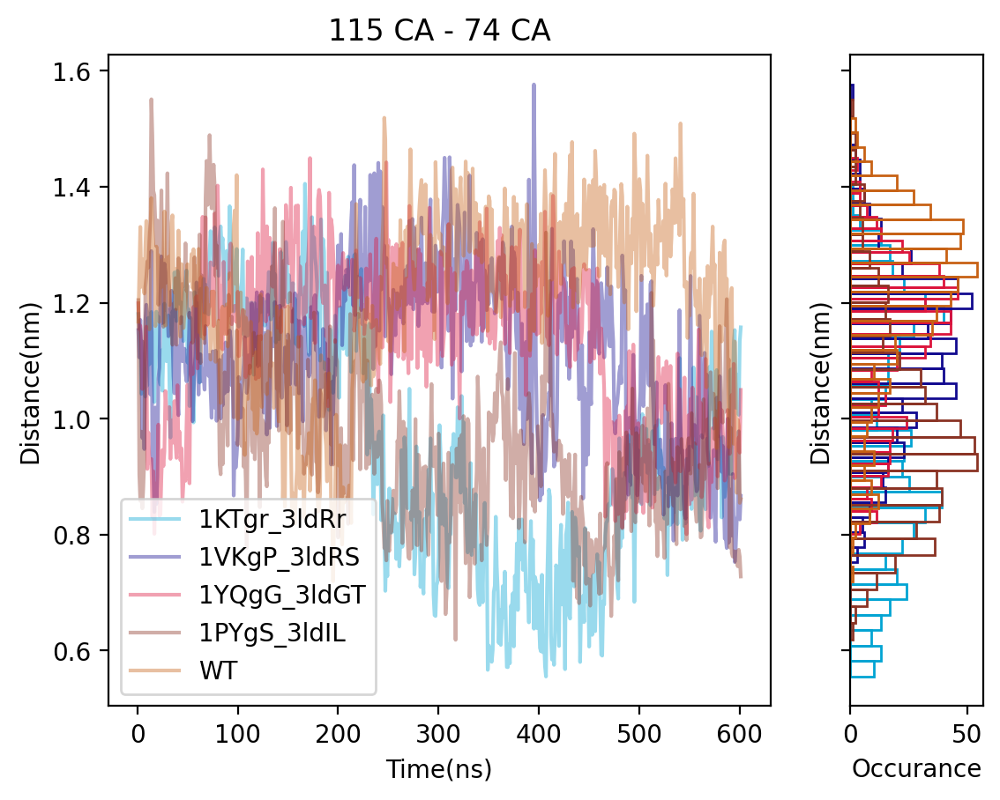

In [107]:
light_color_palette = [
    '#02A4D3',  # Verdigris
    '#120A8F',  # Ultramarine
    '#DC143C',  # Crimson
    '#8A3324',  # Burnt Sienna
    '#C76114',  # Raw Sienna
    '#CC7722',  # Ochre
    '#E34234',  # Vermilion
    '#FFFFFF',  # Lead White
    '#FADA5E',  # Naples Yellow
    '#007BA7'   # Cerulean Blue
]

# You can access colors by index, e.g., renaissance_colors[0] will give you 'Verdigris'.


# You can access colors by index, e.g., color_palette[0] will give you the first color.


pairs0 = np.array([[1110,1027]], dtype=np.int32)
pairs1 = np.array([[1110,1027]], dtype=np.int32)
pairs2 = np.array([[1110,1027]], dtype=np.int32)
pairs3 = np.array([[1110,1027]], dtype=np.int32)
pairs4 = np.array([[1110,1027]], dtype=np.int32)

y0 = md.compute_distances(traj0, pairs0, periodic=True, opt=True) 
y1 = md.compute_distances(traj1, pairs1, periodic=True, opt=True)
y2 = md.compute_distances(traj2, pairs2, periodic=True, opt=True)
y3 = md.compute_distances(traj3, pairs3, periodic=True, opt=True)
y4 = md.compute_distances(traj4, pairs4, periodic=True, opt=True)
#y3 = md.compute_distances(traj3, pairs, periodic=True, opt=True)
t0 = np.arange(len(y0))+1
t1 = np.arange(len(y1))+1
t2 = np.arange(len(y2))+1
t3 = np.arange(len(y3))+1
t4 = np.arange(len(y4))+1
fig, (ax, axhist) = plt.subplots(ncols=2, dpi=200, sharey=True,
                                 gridspec_kw={"width_ratios" : [5,1], "wspace" : 0.2})
ax.plot(t0, y0, color = light_color_palette[0] , label='1KTgr_3ldRr', alpha = 0.4)
ax.plot(t1, y1, color = light_color_palette[1] , label='1VKgP_3ldRS', alpha = 0.4)
ax.plot(t2, y2, color = light_color_palette[2] , label='1YQgG_3ldGT', alpha = 0.4)
ax.plot(t3, y3, color = light_color_palette[3] , label='1PYgS_3ldIL', alpha = 0.4)
ax.plot(t4, y4, color = light_color_palette[4] , label='WT', alpha = 0.4)
#ax.plot(t/100, y3, color = 'm',label='cgRNA')

axhist.hist(y0, bins=32, ec=light_color_palette[0] , fc="none", orientation="horizontal")
axhist.hist(y1, bins=32, ec=light_color_palette[1] , fc="none", orientation="horizontal")
axhist.hist(y2, bins=32, ec=light_color_palette[2] , fc="none", orientation="horizontal")
axhist.hist(y3, bins=32, ec=light_color_palette[3] , fc="none", orientation="horizontal")
axhist.hist(y4, bins=32, ec=light_color_palette[4] , fc="none", orientation="horizontal")
#axhist.hist(y3, bins=32, ec="m", fc="none", orientation="horizontal")
ax.set_xlabel('Time(ns)')
ax.set_title('115 CA - 74 CA')
ax.set_ylabel('Distance(nm)')
ax.legend()
axhist.set_ylabel('Distance(nm)')
axhist.set_xlabel('Occurance')
#plt.xlabel('Distance(nm)')
#plt.ylabel('Occurance')


In [44]:
import os
import pandas as pd
import numpy as np


def read_pdb_as_dataframe(file_path):
    # Read the contents of the PDB file
    with open(file_path, 'r') as file:
        lines = file.readlines()

    # Extract atom information from the lines and store it in a list of dictionaries
    atom_records = []
    for line in lines:
        if line.startswith('ATOM') or line.startswith('HETATM')  :
            atom_record = {
                'type':str(line[:6].strip()),
                'serial': int(line[6:11].strip()),
                'name': line[12:16].strip(),
                'residue_name': line[17:20].strip(),
                'chain_id': line[21],
                'residue_number': int(line[22:26].strip()),
                'x': float(line[30:38].strip()),
                'y': float(line[38:46].strip()),
                'z': float(line[46:54].strip()),
                'occupancy': float(line[54:60].strip()),
                'bfactor': float(line[60:66].strip()),
                'element': line[76:78].strip()
            }
            atom_records.append(atom_record)

    # Create a DataFrame from the atom records
    df = pd.DataFrame(atom_records)

    return df

In [178]:
# Specify the path to your PDB file
pdb_file_path = '1KTgr_3ldRr_2RS_4LK/md_final.pdb'

# Read the PDB file as a DataFrame
pdb_df = read_pdb_as_dataframe(pdb_file_path)

# Measuring the angle of the binding pocket 

# Print the resulting DataFrame
num1 = pdb_df[(pdb_df['residue_number']==182) & (pdb_df['name']=='CA')]['serial'].tolist()[0]
num2 = pdb_df[(pdb_df['residue_number']==186) & (pdb_df['name']=='CA')]['serial'].tolist()[0]
num3 = pdb_df[(pdb_df['residue_number']==195) & (pdb_df['name']=='CA')]['serial'].tolist()[0]
num4 = pdb_df[(pdb_df['residue_number']==148) & (pdb_df['name']=='CA')]['serial'].tolist()[0]
num5 = pdb_df[(pdb_df['residue_number']==153) & (pdb_df['name']=='CA')]['serial'].tolist()[0]
num6 = pdb_df[(pdb_df['residue_number']==160) & (pdb_df['name']=='CA')]['serial'].tolist()[0]
num7 = pdb_df[(pdb_df['residue_number']==115) & (pdb_df['name']=='CA')]['serial'].tolist()[0]
num8 = pdb_df[(pdb_df['residue_number']==119) & (pdb_df['name']=='CA')]['serial'].tolist()[0]
num9 = pdb_df[(pdb_df['residue_number']==126) & (pdb_df['name']=='CA')]['serial'].tolist()[0]

# Print the resulting DataFrame
pocket_lst1 = np.arange(106, 120)
pocket_lst2 = np.arange(138, 154)
pocket_lst3 = np.arange(173, 187)


index_lst1 = [] 
for i in pocket_lst1: 
    index_lst1.append(pdb_df[(pdb_df['residue_number']== i)]['serial'].tolist())
    
index_lst2 = [] 
for i in pocket_lst2: 
    index_lst2.append(pdb_df[(pdb_df['residue_number']== i)]['serial'].tolist())

index_lst3 = [] 
for i in pocket_lst3: 
    index_lst3.append(pdb_df[(pdb_df['residue_number']== i)]['serial'].tolist())


print('[ Angle 1] ')
print(num1, num2, num3)
print('[ Angle 2] ')
print(num4, num5, num6)
print('[ Angle 3] ')
print(num7, num8, num9)
print('[ lib1 ] ')
for lst in index_lst1:
    print(' '.join(str(item) for item in lst))
print('[ lib3 ] ')
for lst in index_lst2:
    print(' '.join(str(item) for item in lst))
print('[ lib5 ] ')
for lst in index_lst3:
    print(' '.join(str(item) for item in lst))

# Print the resulting DataFrame
num1 = pdb_df[(pdb_df['residue_number']==119) & (pdb_df['name']=='CA')]['serial'].tolist()[0]
num2 = pdb_df[(pdb_df['residue_number']==153) & (pdb_df['name']=='CA')]['serial'].tolist()[0]
num3 = pdb_df[(pdb_df['residue_number']==186) & (pdb_df['name']=='CA')]['serial'].tolist()[0]
num4 = pdb_df[(pdb_df['residue_number']==123) & (pdb_df['name']=='CA')]['serial'].tolist()[0]
num5 = pdb_df[(pdb_df['residue_number']==156) & (pdb_df['name']=='CA')]['serial'].tolist()[0]
num6 = pdb_df[(pdb_df['residue_number']==190) & (pdb_df['name']=='CA')]['serial'].tolist()[0]
num7 = pdb_df[(pdb_df['residue_number']==126) & (pdb_df['name']=='CA')]['serial'].tolist()[0]
num8 = pdb_df[(pdb_df['residue_number']==160) & (pdb_df['name']=='CA')]['serial'].tolist()[0]
num9 = pdb_df[(pdb_df['residue_number']==196) & (pdb_df['name']=='CA')]['serial'].tolist()[0]

print('[ Plane 1] ')
print(num1, num2, num3)
print('[ Plane 2] ')
print(num4, num5, num6)
print('[ Plane 3] ')
print(num7, num8, num9)

[ Angle 1] 
2161 2225 2375
[ Angle 2] 
1650 1721 1823
[ Angle 3] 
1137 1196 1314
[ lib1 ] 
999 1000 1001 1002 1003 1004 1005 1006 1007 1008 1009 1010
1011 1012 1013 1014 1015 1016 1017 1018 1019 1020 1021 1022 1023 1024 1025 1026 1027 1028 1029 1030 1031 1032 1033 1034
1035 1036 1037 1038 1039 1040 1041 1042 1043 1044 1045 1046
1047 1048 1049 1050 1051 1052 1053 1054 1055 1056 1057 1058 1059 1060 1061 1062
1063 1064 1065 1066 1067 1068 1069 1070 1071 1072 1073 1074
1075 1076 1077 1078 1079 1080 1081 1082 1083 1084
1085 1086 1087 1088 1089 1090 1091 1092 1093 1094 1095 1096 1097 1098 1099 1100
1101 1102 1103 1104 1105 1106 1107 1108 1109 1110 1111 1112
1113 1114 1115 1116 1117 1118 1119 1120 1121 1122 1123 1124 1125 1126 1127 1128 1129 1130 1131 1132 1133 1134
1135 1136 1137 1138 1139 1140 1141 1142 1143 1144 1145 1146 1147 1148
1149 1150 1151 1152 1153 1154 1155
1156 1157 1158 1159 1160 1161 1162 1163 1164 1165 1166 1167 1168 1169 1170 1171 1172 1173 1174 1175 1176 1177 1178 1179
1180 

In [98]:
# Specify the path to your PDB file
pdb_file_path = 'WT/md_final.pdb'

# Read the PDB file as a DataFrame
pdb_df = read_pdb_as_dataframe(pdb_file_path)

# Measuring the angle of the binding pocket 

# Print the resulting DataFrame
num1 = pdb_df[(pdb_df['residue_number']==119) & (pdb_df['name']=='CA')]['serial'].tolist()[0]
num2 = pdb_df[(pdb_df['residue_number']==153) & (pdb_df['name']=='CA')]['serial'].tolist()[0]
num3 = pdb_df[(pdb_df['residue_number']==186) & (pdb_df['name']=='CA')]['serial'].tolist()[0]
num4 = pdb_df[(pdb_df['residue_number']==123) & (pdb_df['name']=='CA')]['serial'].tolist()[0]
num5 = pdb_df[(pdb_df['residue_number']==156) & (pdb_df['name']=='CA')]['serial'].tolist()[0]
num6 = pdb_df[(pdb_df['residue_number']==190) & (pdb_df['name']=='CA')]['serial'].tolist()[0]
num7 = pdb_df[(pdb_df['residue_number']==126) & (pdb_df['name']=='CA')]['serial'].tolist()[0]
num8 = pdb_df[(pdb_df['residue_number']==160) & (pdb_df['name']=='CA')]['serial'].tolist()[0]
num9 = pdb_df[(pdb_df['residue_number']==196) & (pdb_df['name']=='CA')]['serial'].tolist()[0]

print('[ Plane 1] ')
print(num1, num2, num3)
print('[ Plane 2] ')
print(num4, num5, num6)
print('[ Plane 3] ')
print(num7, num8, num9)

[ Plane 1] 
1189 1681 2172
[ Plane 2] 
1257 1727 2235
[ Plane 3] 
1290 1771 2344


In [99]:
# Specify the PDB files
pdb_files = [
    '1KTgr_3ldRr/md_final.pdb',
    '1VKgP_3ldRS/md_final.pdb',
    '1YQgG_3ldGT/md_final.pdb',
    '1PYgS_3ldIL/md_final.pdb',
    'WT/md_final.pdb'
]

# Create an empty list to store the DataFrames
pdb_dfs = []

# Read PDB files as DataFrames
for pdb_file in pdb_files:
    pdb_df = read_pdb_as_dataframe(pdb_file)
    pdb_dfs.append(pdb_df)

# Define the residue and atom names
residue_atom_info = [
    (133, 'NH1', 'serial'),
    (171, 'OE2', 'serial')
]

# Loop through the PDB DataFrames and residue/atom info
print('[DNA and DNA Binding]')
for pdb_df in pdb_dfs:
    for residue_number, atom_name, column_name in residue_atom_info:
        num = pdb_df[(pdb_df['residue_number'] == residue_number) & (pdb_df['name'] == atom_name)][column_name].tolist()[0]
        print(num, end=',')
    print()


[DNA and DNA Binding]
1409,1977,
1401,1956,
1394,1935,
1395,1953,
1402,1963,


In [ ]:
    '1KTgr_3ldRr', '1PYgS_3ldIL', '1VKgP_3ldRS', '1YQgG_3ldGT', 'WT', '2CW', '1IQgr_3ldRr', '1AngK_3ldVP', '1DKgP_3ldLS', '1KTgr_3ldRr_2RS_4LK', '1RSgA_5edSKgE', '1TVgR_3ldRr', '2VD_4RW'

# interaction map 

In [22]:

# Define the universes
u   = mda.Universe(        '1KTgr_3ldRr/md_final.pdb',         '1KTgr_3ldRr/md_final.pdb')
u1  = mda.Universe(        '1PYgS_3ldIL/md_final.pdb',         '1PYgS_3ldIL/md_final.pdb')
u2  = mda.Universe(        '1VKgP_3ldRS/md_final.pdb',         '1VKgP_3ldRS/md_final.pdb')
u3  = mda.Universe(        '1YQgG_3ldGT/md_final.pdb',         '1YQgG_3ldGT/md_final.pdb')
u4  = mda.Universe(                 'WT/md_final.pdb',                  'WT/md_final.pdb')
u5  = mda.Universe(                '2CW/md_final.pdb',                 '2CW/md_final.pdb')
u6  = mda.Universe(        '1IQgr_3ldRr/md_final.pdb',         '1IQgr_3ldRr/md_final.pdb')
u7  = mda.Universe(        '1AngK_3ldVP/md_final.pdb',         '1AngK_3ldVP/md_final.pdb')
u8  = mda.Universe(        '1DKgP_3ldLS/md_final.pdb',         '1DKgP_3ldLS/md_final.pdb')
u9  = mda.Universe('1KTgr_3ldRr_2RS_4LK/md_final.pdb', '1KTgr_3ldRr_2RS_4LK/md_final.pdb')
u10 = mda.Universe(      '1RSgA_5edSKgE/md_final.pdb',       '1RSgA_5edSKgE/md_final.pdb')
u11 = mda.Universe(        '1TVgR_3ldRr/md_final.pdb',         '1TVgR_3ldRr/md_final.pdb')
u12 = mda.Universe(            '2VD_4RW/md_final.pdb',             '2VD_4RW/md_final.pdb')

# Select the atoms of interest in each universe
LID_ca   = u.select_atoms('resid 1-400 and name CA')
NMP_ca   = u.select_atoms('resid 1-400 and name CA')
LID_ca1 = u1.select_atoms('resid 1-400 and name CA')
NMP_ca1 = u1.select_atoms('resid 1-400 and name CA')
LID_ca2 = u2.select_atoms('resid 1-400 and name CA')
NMP_ca2 = u2.select_atoms('resid 1-400 and name CA')
LID_ca3 = u3.select_atoms('resid 1-400 and name CA')
NMP_ca3 = u3.select_atoms('resid 1-400 and name CA')
LID_ca4 = u4.select_atoms('resid 1-400 and name CA')
NMP_ca4 = u4.select_atoms('resid 1-400 and name CA')
LID_ca5 = u5.select_atoms('resid 1-400 and name CA')
NMP_ca5 = u5.select_atoms('resid 1-400 and name CA')
LID_ca6 = u6.select_atoms('resid 1-400 and name CA')
NMP_ca6 = u6.select_atoms('resid 1-400 and name CA')
LID_ca7 = u7.select_atoms('resid 1-400 and name CA')
NMP_ca7 = u7.select_atoms('resid 1-400 and name CA')
LID_ca8 = u8.select_atoms('resid 1-400 and name CA')
NMP_ca8 = u8.select_atoms('resid 1-400 and name CA')
LID_ca9 = u9.select_atoms('resid 1-400 and name CA')
NMP_ca9 = u9.select_atoms('resid 1-400 and name CA')
LID_ca10 = u10.select_atoms('resid 1-400 and name CA')
NMP_ca10 = u10.select_atoms('resid 1-400 and name CA')
LID_ca11 = u11.select_atoms('resid 1-400 and name CA')
NMP_ca11 = u11.select_atoms('resid 1-400 and name CA')
LID_ca12 = u12.select_atoms('resid 1-400 and name CA')
NMP_ca12 = u12.select_atoms('resid 1-400 and name CA')


# Calculate the distance array for each universe
dist_arr    = mda.lib.distances.distance_array(LID_ca.positions, NMP_ca.positions, box=u.dimensions)
dist_arr_1  = mda.lib.distances.distance_array(LID_ca1.positions, NMP_ca1.positions, box=u1.dimensions)
dist_arr_2  = mda.lib.distances.distance_array(LID_ca2.positions, NMP_ca2.positions, box=u2.dimensions)
dist_arr_3  = mda.lib.distances.distance_array(LID_ca3.positions, NMP_ca3.positions, box=u3.dimensions)
dist_arr_4  = mda.lib.distances.distance_array(LID_ca4.positions, NMP_ca4.positions, box=u4.dimensions)
dist_arr_5  = mda.lib.distances.distance_array(LID_ca5.positions, NMP_ca5.positions, box=u5.dimensions)
dist_arr_6  = mda.lib.distances.distance_array(LID_ca6.positions, NMP_ca6.positions, box=u6.dimensions)
dist_arr_7  = mda.lib.distances.distance_array(LID_ca7.positions, NMP_ca7.positions, box=u7.dimensions)
dist_arr_8  = mda.lib.distances.distance_array(LID_ca8.positions, NMP_ca8.positions, box=u8.dimensions)
dist_arr_9  = mda.lib.distances.distance_array(LID_ca9.positions, NMP_ca9.positions, box=u9.dimensions)
dist_arr_10 = mda.lib.distances.distance_array(LID_ca10.positions, NMP_ca10.positions, box=u10.dimensions)
dist_arr_11 = mda.lib.distances.distance_array(LID_ca11.positions, NMP_ca11.positions, box=u11.dimensions)
dist_arr_12 = mda.lib.distances.distance_array(LID_ca12.positions, NMP_ca12.positions, box=u12.dimensions)


In [ ]:
dist_arr_5 , dist_arr_6 , dist_arr_7 , dist_arr_8 , dist_arr_9 , dist_arr_10, dist_arr_11, dist_arr_12

In [159]:
from matplotlib.patches import Arc

# Create a random distance matrix for dist_arr to dist_arr_4
distance_matrices = [dist_arr, dist_arr_1, dist_arr_2, dist_arr_3, dist_arr_4, dist_arr_5 , dist_arr_6 , dist_arr_7 , dist_arr_8 , dist_arr_9 , dist_arr_10, dist_arr_11, dist_arr_12]
labels = ['1KTgr_3ldRr', '1PYgS_3ldIL', '1VKgP_3ldRS', '1YQgG_3ldGT', 'WT', '2CW', '1IQgr_3ldRr', '1AngK_3ldVP', '1DKgP_3ldLS', '1KTgr_3ldRr_2RS_4LK', '1RSgA_5edSKgE', '1TVgR_3ldRr', '2VD_4RW']
color_lst = ['maroon', 'forestgreen', 'lightcoral', 'royalblue', 'black', 'royalblue', 'coral','maroon','lightcoral', 'purple', 'salmon', 'red', 'tomato']

# Set the distance threshold for interactions
threshold = 7  # Adjust this threshold as needed

# Determine the number of rows and columns for subplots
num_matrices = len(distance_matrices)
num_rows = 4  # Add 1 to round up
num_columns = 4

# Create subplots based on the number of matrices
fig, axes = plt.subplots(nrows=num_rows, ncols= num_columns, figsize=(24, 18), dpi=600)


for index, distance_matrix in enumerate(distance_matrices):
    # Create an empty undirected graph
    G = nx.Graph()
    
    # Add nodes (residues) to the graph with labels
    residue_labels = [f'{i}' for i in range(1, len(distance_matrix) + 1)]
    G.add_nodes_from(residue_labels)
    
    # Find indices of pairs where distance <= threshold
    i, j = np.where(distance_matrix <= threshold)
    
    # Add edges (interactions) based on the distance threshold
    for x, y in zip(i, j):
        if x < y:
            G.add_edge(residue_labels[x], residue_labels[y], weight=distance_matrix[x, y])
    
    # Filter edges based on the distance threshold
    filtered_edges = [(u, v, d) for u, v, d in G.edges(data=True) if d['weight'] <= threshold]
    
    # Create a new graph with filtered edges
    G_filtered = G.copy()
    G_filtered.remove_edges_from(G.edges())
    G_filtered.add_edges_from(filtered_edges)
    
    # Arrange nodes in a circular layout
    pos = nx.circular_layout(G_filtered)
    
    # Extract edge distances to determine edge colors
    edge_distances = [G_filtered[i][j]['weight'] for i, j in G_filtered.edges()]
    
    # Create a colormap for edge colors
    cmap = plt.get_cmap('viridis')  # You can choose any colormap you prefer
    
    # Create a ScalarMappable for the color bar
    sm = ScalarMappable(cmap=cmap, norm=plt.Normalize(vmin=min(edge_distances), vmax=max(edge_distances)))
    sm.set_array([])

    # Convert the nodes to integers
    nodes_as_int = [int(node) for node in G_filtered.nodes()]
    
    # Add a dummy node between the first and last nodes for empty space
    dummy_node = max(nodes_as_int) + 1
    node_positions = {node: (theta, r) for node, (theta, r) in zip(G_filtered.nodes(), pos.values())}
    node_positions[dummy_node] = (0, 0)  # Adjust the position as needed
    
    # Convert node labels back to strings
    node_labels = {str(node): str(node) if int(node) == 1 or int(node) % 25 == 0 or int(node) == len(distance_matrix) - 5 else'' for node in nodes_as_int}

    
    # Plot the interaction network with nodes in a circle and labels
    nx.draw(G_filtered, pos=node_positions, with_labels=True, labels=node_labels,
            node_size=200, node_color='skyblue', font_size=12, font_color='black',
            edgelist=G_filtered.edges(), edge_color=edge_distances, edge_cmap=cmap, width=2, ax=axes[index // 4, index % 4])
    
    # Set the dummy node color to white
    
    # Create a color bar for edge distances
    cbar = plt.colorbar(sm, label='Distance', ax=axes[index // 4, index % 4])
    # Make the color bar label bold
    cbar.set_ticks([min(edge_distances), max(edge_distances)])  # Set color bar ticks
    cbar.set_ticklabels(['0 $\AA$', f'{threshold} $\AA$'], fontsize =14)  # Set tick labels
    cbar.ax.set_ylabel('Distance', fontsize=16, fontweight='bold')
    axes[index // 4, index % 4].set_title(labels[index], fontsize = 24)
    # Get the positions of the nodes
    node_positions = {node: (theta, r) for node, (theta, r) in zip(G_filtered.nodes(), pos.values())}
    
    # Calculate the maximum radial position of the nodes
    max_r = max([r for _, r in node_positions.values()])
    
    # Calculate the radius and center for the arc
    arc_radius = max_r * 1.2  # Adjust the factor as needed
    arc_center = (0, 0)  # You can adjust the center position if required
    
    # Define the arc parameters (angle and width)
    start_angle = 0  # Starting angle in degrees
    end_angle = 125  # Ending angle in degrees
    arc_width = 2.5  # Width of the arc
    
    # Draw the arc
    arc = Arc(arc_center, arc_radius * 2, arc_radius * 2, angle=0, theta1=start_angle, theta2=end_angle,
              linewidth=arc_width, color='grey', linestyle='--')
    axes[index // 4, index % 4].add_patch(arc)
    # Label for the arc
    arc_label = 'CD 1 '  # Change this label as needed
    
    # Calculate the position for the arc label
    label_x = arc_center[0] #+ arc_radius * 1  # Adjust the position as needed
    label_y = arc_center[1] + arc_radius * 0.925  # Adjust the position as needed
    
    # Annotate the arc with the label
    axes[index // 4, index % 4].annotate(arc_label, (label_x, label_y), fontsize=14, ha='center', va='center')
    
    # Define the arc parameters (angle and width)
    start_angle = 125  # Starting angle in degrees
    end_angle = 157  # Ending angle in degrees
    arc_width = 2.5  # Width of the arc
    
    # Draw the arc
    arc = Arc(arc_center, arc_radius * 2, arc_radius * 2, angle=0, theta1=start_angle, theta2=end_angle,
              linewidth=arc_width, color='orange', linestyle='--')
    axes[index // 4, index % 4].add_patch(arc)
    # Label for the arc
    arc_label = 'Loop 1'  # Change this label as needed
    
    # Calculate the position for the arc label
    label_x = arc_center[0] - arc_radius * 1  # Adjust the position as needed
    label_y = arc_center[1] + arc_radius * 0.75  # Adjust the position as needed
    
    # Annotate the arc with the label
    axes[index // 4, index % 4].annotate(arc_label, (label_x, label_y), fontsize=14, color='orange', ha='center', va='center')
    
    # Define the arc parameters (angle and width)
    start_angle = 185  # Starting angle in degrees
    end_angle = 225  # Ending angle in degrees
    arc_width = 2.5  # Width of the arc
    
    # Draw the arc
    arc = Arc(arc_center, arc_radius * 2, arc_radius * 2, angle=0, theta1=start_angle, theta2=end_angle,
              linewidth=arc_width, color='brown', linestyle='--')
    axes[index // 4, index % 4].add_patch(arc)
    # Label for the arc
    arc_label = 'Loop 3'  # Change this label as needed
    
    # Calculate the position for the arc label
    label_x = arc_center[0] - arc_radius * 0.95  # Adjust the position as needed
    label_y = arc_center[1] - arc_radius * 0.65  # Adjust the position as needed
    
    # Annotate the arc with the label
    axes[index // 4, index % 4].annotate(arc_label, (label_x, label_y), fontsize=14, color='brown', ha='center', va='center')
    
    # Define the arc parameters (angle and width)
    start_angle = 265  # Starting angle in degrees
    end_angle = 300  # Ending angle in degrees
    arc_width = 2.5  # Width of the arc
    
    # Draw the arc
    arc = Arc(arc_center, arc_radius * 2, arc_radius * 2, angle=0, theta1=start_angle, theta2=end_angle,
              linewidth=arc_width, color='salmon', linestyle='--')
    axes[index // 4, index % 4].add_patch(arc)
    # Label for the arc
    arc_label = 'Loop 5'  # Change this label as needed
    
    # Calculate the position for the arc label
    label_x = arc_center[0] + arc_radius * 0.55  # Adjust the position as needed
    label_y = arc_center[1] - arc_radius * 0.95  # Adjust the position as needed
    
    # Annotate the arc with the label
    axes[index // 4, index % 4].annotate(arc_label, (label_x, label_y), fontsize=14, color='salmon', ha='center', va='center')
    

# Turn off any remaining subplots
axes[-1,-1].axis('off')
axes[-1,-2].axis('off')
axes[-1,-3].axis('off')
fig.text(0.5, 1.0, f'Protein Interaction Network (Threshold = {threshold} $\AA$)', fontsize=22, ha='center')

# Adjust subplot layout
plt.tight_layout()

# Display the subplots
plt.show()

# edges from Ring

In [95]:
import pandas as pd
def read_df_from_edge(filename):
    
    # Define the column names based on your data format
    columns = [
        "NodeId1",
        "Interaction",
        "NodeId2",
        "Distance",
        "Angle",
        "Energy",
        "Atom1",
        "Atom2",
        "Donor",
        "Positive",
        "Cation",
        "Orientation",
        "Model"
    ]
    
    # Read the file into a DataFrame
    df = pd.read_csv(filename, delimiter="\t", header=None, names=columns,skiprows=1)
    
    # Split "NodeId1" into three columns: A, 52, and TRP
    node1_split = df["NodeId1"].str.split(":", expand=True)
    node1_split.columns = ["A", "B", "C", "D"]
    
    # Split "NodeId2" into three columns: A, 72, and GLN
    node2_split = df["NodeId2"].str.split(":", expand=True)
    node2_split.columns = ["E", "F", "G", "H"]
    
    # Concatenate the split columns to the original DataFrame
    df = pd.concat([df, node1_split, node2_split], axis=1)
    
    # Drop the original "NodeId1" and "NodeId2" columns
    df.drop(["NodeId1", "NodeId2"], axis=1, inplace=True)
    
    df['B'] = df['B'].fillna(0).astype(int)
    df['F'] = df['F'].fillna(0).astype(int)
    # Display the modified DataFrame
    return df 

In [91]:
df0  = read_df_from_edge('Ring_Edges/1KTgr_3ldRr_edges')
df1  = read_df_from_edge('Ring_Edges/1PYgS_3ldIL_edges')
df2  = read_df_from_edge('Ring_Edges/1VKgP_3ldRS_edges')
df3  = read_df_from_edge('Ring_Edges/1YQgG_3ldGT_edges')
df4  = read_df_from_edge('Ring_Edges/WT_edges')
df5  = read_df_from_edge('Ring_Edges/2CW_edges')
df6  = read_df_from_edge('Ring_Edges/1IQgr_3ldRr_edges')
df7  = read_df_from_edge('Ring_Edges/1AngK_3ldVP_edges')
df8  = read_df_from_edge('Ring_Edges/1DKgP_3ldLS_edges')
df9  = read_df_from_edge('Ring_Edges/1KTgr_3ldRr_2RS_4LK_edges')
df10 = read_df_from_edge('Ring_Edges/1RSgA_5edSKgE_edges')
df11 = read_df_from_edge('Ring_Edges/1TVgR_3ldRr_edges')
df12 = read_df_from_edge('Ring_Edges/2VD_4RW_edges')

In [115]:
df0

,Interaction,Distance,Angle,Energy,Atom1,Atom2,Donor,Positive,Cation,Orientation,Model,A,B,C,D,E,F,G,H
0,VDW:SC_SC,3.707,NaN,6.0,CG1,CG2,NaN,NaN,NaN,NaN,1,_,42,_,VAL,_,76,_,ILE
1,VDW:SC_SC,3.835,NaN,6.0,CG1,CG2,NaN,NaN,NaN,NaN,1,_,42,_,VAL,_,80,_,VAL
2,VDW:MC_SC,3.747,NaN,6.0,C,CD,NaN,NaN,NaN,NaN,1,_,43,_,ASN,_,60,_,ILE
3,VDW:SC_SC,3.808,NaN,6.0,CB,CG1,NaN,NaN,NaN,NaN,1,_,43,_,ASN,_,60,_,ILE
4,HBOND:SC_MC,2.944,18.146,17.0,ND2,O,_:43:_:ASN,NaN,NaN,NaN,1,_,43,_,ASN,_,61,_,GLU
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
125,VDW:MC_SC,3.414,NaN,6.0,C,ND2,NaN,NaN,NaN,NaN,1,_,198,_,PRO,_,201,_,ASN
126,VDW:SC_SC,3.212,NaN,6.0,OD1,CB,NaN,NaN,NaN,NaN,1,_,201,_,ASN,_,204,_,GLN
127,VDW:SC_SC,3.776,NaN,6.0,CE2,CD,NaN,NaN,NaN,NaN,1,_,205,_,PHE,_,209,_,ILE
128,VDW:SC_SC,3.750,NaN,6.0,CG,CD1,NaN,NaN,NaN,NaN,1,_,207,_,ARG,_,211,_,LEU


In [156]:
lol0  =  df0[((df0  ['B'] < 174) & (df0  ['B'] > 152)) | ((df0  ['F'] < 174) & (df0  ['F'] > 152))] 
lol1  =  df1[((df1  ['B'] < 174) & (df1  ['B'] > 152)) | ((df1  ['F'] < 174) & (df1  ['F'] > 152))] 
lol2  =  df2[((df2  ['B'] < 174) & (df2  ['B'] > 152)) | ((df2  ['F'] < 174) & (df2  ['F'] > 152))] 
lol3  =  df3[((df3  ['B'] < 174) & (df3  ['B'] > 152)) | ((df3  ['F'] < 174) & (df3  ['F'] > 152))] 
lol4  =  df4[((df4  ['B'] < 174) & (df4  ['B'] > 152)) | ((df4  ['F'] < 174) & (df4  ['F'] > 152))] 
lol5  =  df5[((df5  ['B'] < 174) & (df5  ['B'] > 152)) | ((df5  ['F'] < 174) & (df5  ['F'] > 152))] 
lol6  =  df6[((df6  ['B'] < 174) & (df6  ['B'] > 152)) | ((df6  ['F'] < 174) & (df6  ['F'] > 152))] 
lol7  =  df7[((df7  ['B'] < 174) & (df7  ['B'] > 152)) | ((df7  ['F'] < 174) & (df7  ['F'] > 152))] 
lol8  =  df8[((df8  ['B'] < 174) & (df8  ['B'] > 152)) | ((df8  ['F'] < 174) & (df8  ['F'] > 152))] 
lol9  =  df9[((df9  ['B'] < 174) & (df9  ['B'] > 152)) | ((df9  ['F'] < 174) & (df9  ['F'] > 152))] 
lol10 = df10[((df10 ['B'] < 174) & (df10 ['B'] > 152)) | ((df10 ['F'] < 174) & (df10 ['F'] > 152))] 
lol11 = df11[((df11 ['B'] < 174) & (df11 ['B'] > 152)) | ((df11 ['F'] < 174) & (df11 ['F'] > 152))] 
lol12 = df12[((df12 ['B'] < 174) & (df12 ['B'] > 152)) | ((df12 ['F'] < 174) & (df12 ['F'] > 152))] 

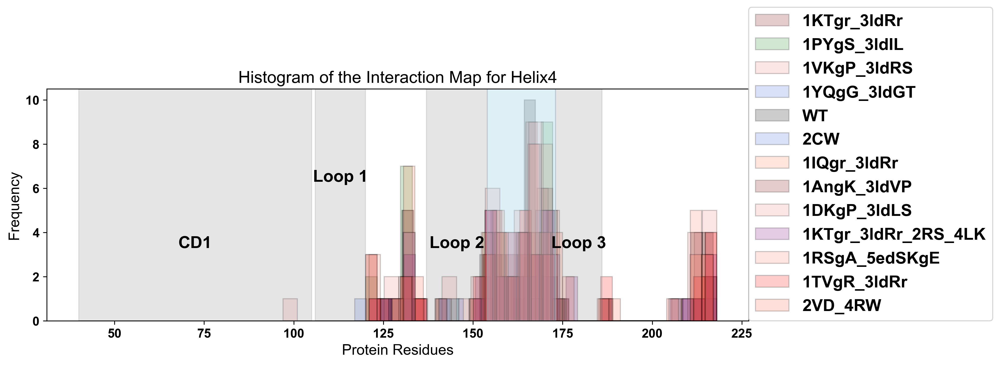

In [158]:


# Assuming you have three DataFrames: new_df, new_df1, and new_df2

# Create a histogram plot
plt.figure(figsize=(12, 4), dpi=300)  # Adjust the figure size (12 units wide, 4 units tall)
labels = ['1KTgr_3ldRr', '1PYgS_3ldIL', '1VKgP_3ldRS', '1YQgG_3ldGT', 'WT', '2CW', '1IQgr_3ldRr', '1AngK_3ldVP', '1DKgP_3ldLS', '1KTgr_3ldRr_2RS_4LK', '1RSgA_5edSKgE', '1TVgR_3ldRr', '2VD_4RW']
color_lst = ['maroon', 'forestgreen', 'lightcoral', 'royalblue', 'black', 'royalblue', 'coral','maroon','lightcoral', 'purple', 'salmon', 'red', 'tomato']

df_lst = [lol0 ,lol1 ,lol2 ,lol3 ,lol4 ,lol5 ,lol6 ,lol7 ,lol8 ,lol9 ,lol10,lol11,lol12]

# Plot the histograms with different colors and labels
for i in range(len(df_lst)):
    plt.hist((df_lst[i][df_lst[i]['Interaction'].str.contains('SC_SC')]['F'].tolist()+df_lst[i][df_lst[i]['Interaction'].str.contains('SC_SC')]['B'].tolist()),bins=30, color=color_lst[i],  edgecolor='black',  alpha=0.2, label=labels[i])
#plt.hist(new_df4['F'].tolist(),bins= 50, color='khaki', edgecolor='black', alpha=0.4, label='homo+hetero')
# Add labels and title
plt.xlabel('Protein Residues', fontsize=14)  # Adjust font size
plt.ylabel('Frequency', fontsize=14)  # Adjust font size
plt.title('Histogram of the Interaction Map for Helix4', fontsize=16)  # Adjust font size

# Show a legend
plt.legend(loc=[1,0])

# Show grid lines
#plt.grid(True, linestyle='--', alpha=0.7)
plt.axvspan(40, 105, color='grey', alpha=0.2)  # Adds a grey box from x=1 to x=283
plt.text((40+105)/2, 3.5, 'CD1', ha='center', va='center')
#
plt.axvspan(106, 120, color='grey', alpha=0.2)
plt.text((106+120)/2, 6.5, 'Loop 1', ha='center', va='center')

plt.axvspan(154, 173, color='lightblue', alpha=0.4)

plt.axvspan(137, 154, color='grey', alpha=0.2)  # Adds a grey box from x=1 to x=283
plt.text((137+154)/2, 3.5, 'Loop 2', ha='center', va='center')

plt.axvspan(173, 186, color='grey', alpha=0.2)  # Adds a grey box from x=1 to x=283
plt.text((173+186)/2, 3.5, 'Loop 3', ha='center', va='center')
# Increase font size for tick labels on both axes
plt.xticks(fontsize=12)
plt.yticks(fontsize=12)

#plt.axvspan(1, 40, color='grey', alpha=0.2)

# Show the plot
plt.show()


# NMA

In [ ]:
import MDAnalysis as mda
from MDAnalysis.analysis import pca

# Load your trajectory file (e.g., in GRO, DCD, or XYZ format) and topology file (e.g., PDB).
# Use the 'stride' argument to skip frames. In this example, we're loading every 50th frame.
u = mda.Universe('WT/md_solu.pdb', 'WT/md_solu.xtc', in_memory=True, stride=500)

protein_atoms = u.select_atoms('protein')

# Perform PCA (Principal Component Analysis) to obtain normal modes.
analysis = pca.PCA(u).run()


In [ ]:
# Plot the eigenvalues (variance explained by each mode).
plt.plot(analysis.variance)
plt.xlabel('Mode Index')
plt.ylabel('Variance')
plt.show()

# Pairwise RMSD

In [290]:
import MDAnalysis as mda
from MDAnalysis.analysis import diffusionmap, align, rms
import numpy as np
import matplotlib.pyplot as plt
%matplotlib inline

In [291]:
u1 = mda.Universe('1KTgr_3ldRr/md_solu.pdb', '1KTgr_3ldRr/md_solu.xtc' , in_memory=True, stride=500)
u2 = mda.Universe('1PYgS_3ldIL/md_solu.pdb', '1PYgS_3ldIL/md_solu.xtc', in_memory=True, stride=500)
u3 = mda.Universe('1VKgP_3ldRS/md_solu.pdb', '1VKgP_3ldRS/md_solu.xtc', in_memory=True, stride=500)
u4 = mda.Universe('1YQgG_3ldGT/md_solu.pdb', '1YQgG_3ldGT/md_solu.xtc', in_memory=True, stride=500)
u5 = mda.Universe('WT/md_solu.pdb', 'WT/md_solu.xtc', in_memory=True, stride=500)

ref = mda.Universe('WT/md_final.pdb')

labels = ['1KTgr_3ldRr', '1PYgS_3ldIL', '1VKgP_3ldRS', '1YQgG_3ldGT', 'WT']

/Users/ericlei/opt/anaconda3/lib/python3.9/site-packages/MDAnalysis/coordinates/XDR.py:237: UserWarning: Reload offsets from trajectory
 ctime or size or n_atoms did not match
  warnings.warn("Reload offsets from trajectory\n "


In [297]:
aligner = align.AlignTraj(u1, u1, select='name CA',
                          in_memory=True).run()

aligner = align.AlignTraj(u2, u2, select='name CA',
                          in_memory=True).run()

aligner = align.AlignTraj(u3, u3, select='name CA',
                          in_memory=True).run()


aligner = align.AlignTraj(u4, u4, select='name CA',
                          in_memory=True).run()

aligner = align.AlignTraj(u5, u5, select='name CA',
                          in_memory=True).run()

In [298]:
matrix = diffusionmap.DistanceMatrix(u1, select='name CA').run()

In [299]:
matrix.dist_matrix.shape

/Users/ericlei/opt/anaconda3/lib/python3.9/site-packages/MDAnalysis/analysis/diffusionmap.py:295: DeprecationWarning: The `dist_matrix` attribute was deprecated in MDAnalysis 2.0.0 and will be removed in MDAnalysis 3.0.0. Please use `results.dist_matrix` instead.
  warnings.warn(wmsg, DeprecationWarning)


(1673, 1673)

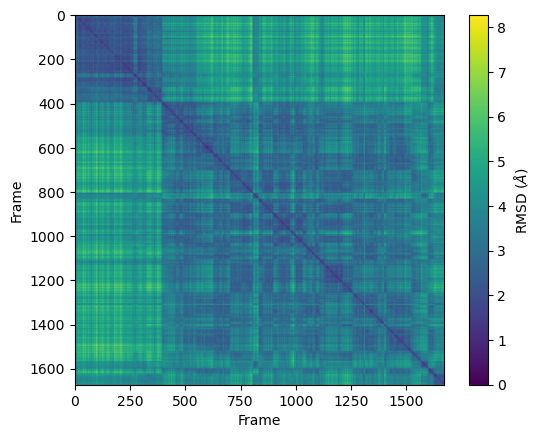

In [300]:
plt.imshow(matrix.dist_matrix, cmap='viridis')
plt.xlabel('Frame')
plt.ylabel('Frame')
plt.colorbar(label=r'RMSD ($\AA$)')

 # traj similarity

In [86]:

import MDAnalysis as mda
from MDAnalysis.analysis import psa
import nglview as nv

import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
%matplotlib inline

In [38]:
u1 = mda.Universe('1KTgr_3ldRr/md_solu.pdb', '1KTgr_3ldRr/md_solu.xtc' , in_memory=True, stride=500)
u2 = mda.Universe('1PYgS_3ldIL/md_solu.pdb', '1PYgS_3ldIL/md_solu.xtc', in_memory=True, stride=500)
u3 = mda.Universe('1VKgP_3ldRS/md_solu.pdb', '1VKgP_3ldRS/md_solu.xtc', in_memory=True, stride=500)
u4 = mda.Universe('1YQgG_3ldGT/md_solu.pdb', '1YQgG_3ldGT/md_solu.xtc', in_memory=True, stride=500)
u5 = mda.Universe('WT/md_solu.pdb', 'WT/md_solu.xtc', in_memory=True, stride=500)

ref = mda.Universe('WT/md_final.pdb')

labels = ['1KTgr_3ldRr', '1PYgS_3ldIL', '1VKgP_3ldRS', '1YQgG_3ldGT', 'WT']

In [62]:
rms.rmsd(u2.select_atoms('backbone').positions,  # coordinates to align
         ref.select_atoms('backbone').positions,  # reference coordinates
         center=True,  # subtract the center of geometry
         superposition=True)  # superimpose coordinates

3.755276248274443

In [49]:
CORE = 'backbone and resid 41-95'
LID = 'backbone and resid 96-197'
NMP = 'backbone and resid 198-222'

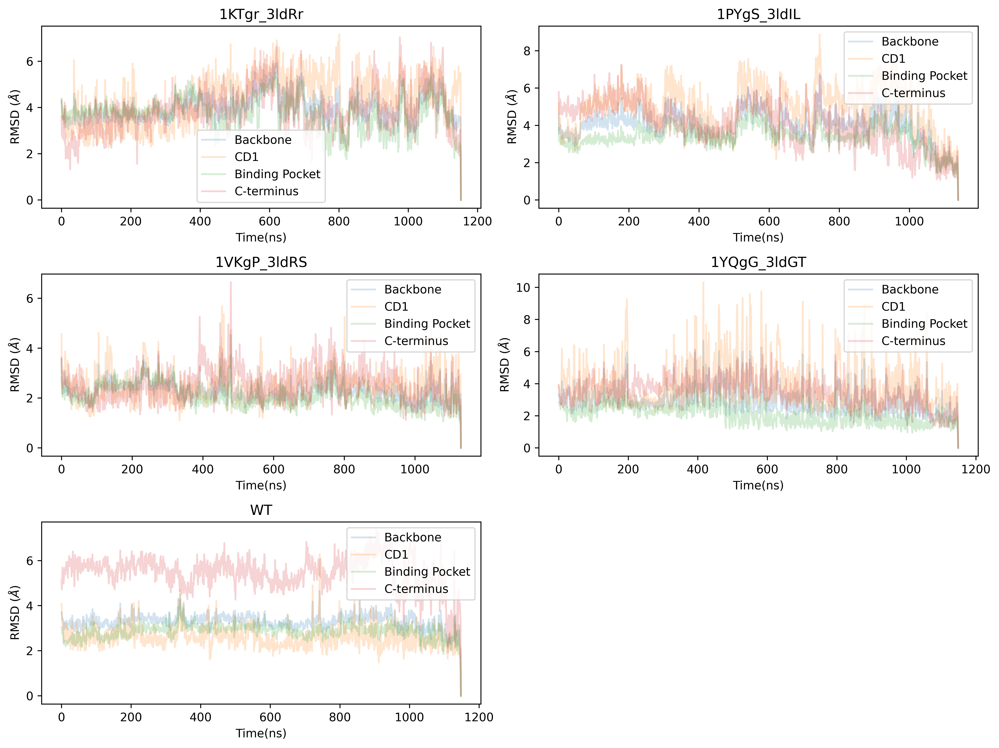

In [73]:

# Create a list of the corresponding RMSD DataFrames
dataframes = []

for u in [u1, u2, u3, u4, u5]:
    R = rms.RMSD(u,  # universe to align
                 u,  # reference universe or atomgroup
                 select='backbone',  # group to superimpose and calculate RMSD
                 groupselections=[CORE, LID, NMP],  # groups for RMSD
                 ref_frame=-1)  # frame index of the reference
    R.run()
    
    df = pd.DataFrame(R.results.rmsd,
                      columns=['Frame', 'Time (ns)', 'Backbone', 'CD1', 'Binding Pocket', 'C-terminus'])
    dataframes.append(df)

# Create a subplot with a 3x2 layout
fig, axes = plt.subplots(3, 2, figsize=(12, 9))
axes[-1, -1].axis('off')
axes = axes.flatten()

for i, df in enumerate(dataframes):
    ax = df.plot(x='Frame', y=['Backbone', 'CD1', 'Binding Pocket', 'C-terminus'],
                 kind='line', alpha=0.2, ax=axes[i])
    ax.set_title(labels[i])
    ax.set_ylabel(r'RMSD ($\AA$)')
    ax.set_xlabel('Time(ns)')

# Set DPI for high resolution
plt.gcf().set_dpi(600)

# Adjust layout to prevent overlap of subplots
plt.tight_layout()

# Show the plot
plt.show()


# salt bridge contacts

In [139]:
u1.trajectory[-1]  # set trajectory to first frame (closed)
# make a new Universe with coordinates of first frame
adk_closed = mda.Merge(u1.atoms).load_new(u1.atoms.positions)
adk_closed_view = nv.show_mdanalysis(adk_closed)
adk_closed_view

NGLWidget()

In [306]:
view = nv.show_mdanalysis(u1)
view

NGLWidget(max_frame=1672)

<AxesSubplot:>

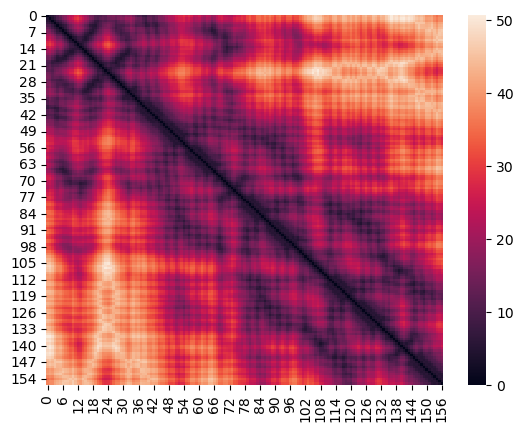

In [134]:
LID_ca = u1.select_atoms('resid 41-197 and name CA')
NMP_ca = u1.select_atoms('resid 41-197 and name CA')
dist_arr = mda.lib.distances.distance_array(LID_ca.positions, NMP_ca.positions, box=u1.dimensions)
sns.heatmap(dist_arr)

In [233]:
import numpy as np
import matplotlib.pyplot as plt

# Example data generation for your code snippet
# Replace this with your actual code
num_samples = 10  # Replace with the actual number of samples
threshold = 4.5


def cal_heatmaps(u):
    matrix = [] 
    heatmaps = []
    for i in range(0, 1100, 100):
        matrix = np.array(u.trajectory[i])
        expanded_matrix = np.expand_dims(matrix, axis=1)
        pairwise_differences = expanded_matrix - matrix
        distance_matrix = np.linalg.norm(pairwise_differences, axis=2)
        contact_matrix = distance_matrix < threshold
        #print(contact_matrix)
        heatmaps.append(contact_matrix)
    return heatmaps
    

# Initialize an empty list to store 3D heatmaps
heatmaps1 = cal_heatmaps(u1)
heatmaps2 = cal_heatmaps(u2)
heatmaps3 = cal_heatmaps(u3)
heatmaps4 = cal_heatmaps(u4)
heatmaps5 = cal_heatmaps(u5)




In [248]:
np.sum(heatmaps1, axis=0)

array([[11, 11, 11, ...,  0,  0,  0],
       [11, 11, 11, ...,  0,  0,  0],
       [11, 11, 11, ...,  0,  0,  0],
       ...,
       [ 0,  0,  0, ..., 11, 11,  0],
       [ 0,  0,  0, ..., 11, 11,  4],
       [ 0,  0,  0, ...,  0,  4, 11]])

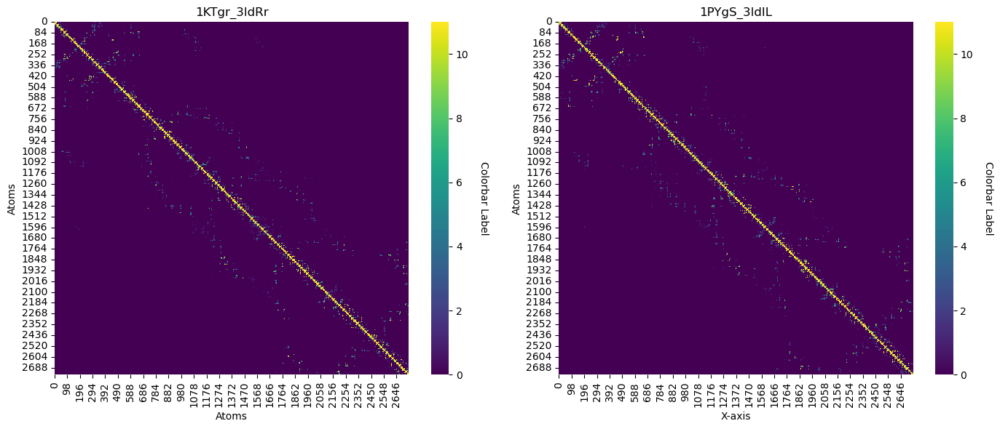

In [265]:


# Create subplots
fig, axes = plt.subplots(1, 2, figsize=(14, 6))

labels = ['1KTgr_3ldRr', '1PYgS_3ldIL', '1VKgP_3ldRS', '1YQgG_3ldGT', 'WT']

# Plot the first heatmap
ax1 = sns.heatmap(np.sum(heatmaps1, axis=0), ax=axes[0], cmap='viridis')
ax1.set_title(labels[0])
ax1.set_xlabel('Atoms')
ax1.set_ylabel('Atoms')

# Plot the second heatmap
ax2 = sns.heatmap(np.sum(heatmaps2, axis=0), ax=axes[1], cmap='viridis')
ax2.set_title(labels[1])
ax2.set_xlabel('X-axis')
ax2.set_ylabel('Atoms')

# Adjust the colorbar
for ax in [ax1, ax2]:
    cbar = ax.collections[0].colorbar
    cbar.set_label('Colorbar Label', rotation=270, labelpad=20)

plt.tight_layout()
plt.show()


In [89]:
#directories=["1PYgS_3ldIL", "1YQgG_3ldGT", "1KTgr_3ldRr", "1VKgP_3ldRS", "1IQgr_3ldRr","WT", "2CW", "1AngK_3ldVP", "1DKgP_3ldLS", "1KTgr_3ldRr_2RS_4LK", "1RSgA_5edSKgE", "1TVgR_3ldRr", "2VD_4RW"]
directories = [
    "Extract_frame_1000000ps.pdb",
    "Extract_frame_1200000ps.pdb",
    "Extract_frame_1400000ps.pdb",
    "Extract_frame_1600000ps.pdb",
    "Extract_frame_1800000ps.pdb",
    "Extract_frame_2000000ps.pdb",
    "Extract_frame_200000ps.pdb",
    "Extract_frame_400000ps.pdb",
    "Extract_frame_600000ps.pdb",
    "Extract_frame_800000ps.pdb"
]

for i, directory in enumerate(directories):
    print('load '+str(directory))
    name = directory.split('.pdb')[0]
    print('align ' +str(name) + ', reference')
    print('contact '+ str(name) + ','+str(name))
    #print('set_name md_final,' +str(directory))
    #print('load '+str(directory) + '/md_final.pdb')
    #print('myview=cmd.get_view()')
    #print('print(myvew)')
    #print('cmd.set_view((-0.9984032511711121, 0.013281738385558128, 0.054905425757169724, -0.03373127058148384, -0.9198321104049683, -0.39085546135902405, 0.04531276598572731, -0.3920842707157135, 0.9188130497932434, 0.0, -0.0, -276.4183654785156, 35.49880599975586, 36.94904708862305, 71.54244232177734, 233.4209442138672, 319.4157409667969, -20.0))')
    #print('orient')
    #print('show surface') 
    #print('color_h')
    #print('align md_final, reference')
    #print('cmd.set_view((-0.9984032511711121, 0.013281738385558128, 0.054905425757169724, -0.03373127058148384, -0.9198321104049683, -0.39085546135902405, 0.04531276598572731, -0.3920842707157135, 0.9188130497932434, 0.0, -0.0, -276.4183654785156, 35.49880599975586, 36.94904708862305, 71.54244232177734, 233.4209442138672, 319.4157409667969, -20.0))')
    #print('set_name md_final,' +str(directory))
    #print('hide reference')
    #print('ray 1200,1200')
    #print('png Visualization_12_12/' +str(directory) +'_H_A.png, dpi=300')
    #print('rotate x, 180')
    #print('hide reference')
    #print('ray 1200,1200')
    #print('png Visualization_12_12/' +str(directory) +'_H_B.png, dpi=300')
    #print('rotate x, 180')
    #print('delete md_final')
    
    
    #print('align md_final, md_solu')
    #print('color blue, md_final')
    #print('orient')
    #print('rotate x, 90')
    #print('ray 1200,1200')
    #print('png Visualization_12_12/' +str(directory) +'_first_last.png, dpi=300')
    #print('delete all')

#set cartoon_transparency, 0.8, all


load Extract_frame_1000000ps.pdb
align Extract_frame_1000000ps, reference
contact Extract_frame_1000000ps,Extract_frame_1000000ps
load Extract_frame_1200000ps.pdb
align Extract_frame_1200000ps, reference
contact Extract_frame_1200000ps,Extract_frame_1200000ps
load Extract_frame_1400000ps.pdb
align Extract_frame_1400000ps, reference
contact Extract_frame_1400000ps,Extract_frame_1400000ps
load Extract_frame_1600000ps.pdb
align Extract_frame_1600000ps, reference
contact Extract_frame_1600000ps,Extract_frame_1600000ps
load Extract_frame_1800000ps.pdb
align Extract_frame_1800000ps, reference
contact Extract_frame_1800000ps,Extract_frame_1800000ps
load Extract_frame_2000000ps.pdb
align Extract_frame_2000000ps, reference
contact Extract_frame_2000000ps,Extract_frame_2000000ps
load Extract_frame_200000ps.pdb
align Extract_frame_200000ps, reference
contact Extract_frame_200000ps,Extract_frame_200000ps
load Extract_frame_400000ps.pdb
align Extract_frame_400000ps, reference
contact Extract_frame_

In [4]:
directories=["1PYgS_3ldIL"]#, "1YQgG_3ldGT", "1KTgr_3ldRr", "1VKgP_3ldRS", "1IQgr_3ldRr", "WT", "2CW", "1AngK_3ldVP", "1DKgP_3ldLS", "1KTgr_3ldRr_2RS_4LK", "1RSgA_5edSKgE", "1TVgR_3ldRr", "2VD_4RW"]
#colors = ['palegreen', 'marine', 'darksalmon', 'darksalmon', 'darksalmon', 'marine', 'darksalmon', 'darksalmon', 'darksalmon', 'darksalmon', 'darksalmon', 'darksalmon']

for i, directory in enumerate(directories):
    #print('load '+str(directory) + '/md_solu.pdb')
    #print('color red, md_solu')
    print('sele polymer.protein')
    print('color gray70, sele')
    print('sele resi 1-285 and polymer.protein')
    print('color skyblue, sele')
    print('sele resi 286-301 and polymer.protein')
    print('color gray50, sele')
    print('sele resi 374-498 and polymer.protein')
    print('color yelloworange, sele')
    print('sele resi 581-746 and polymer.protein')
    print('color gray20, sele')
    print('sele resi 929-1127 and polymer.protein')
    print('color dirtyviolet, sele')
    #print('sele resi 302-374 and polymer.protein')
    #print('set_color yelloworange, sele')
    ##print('myview=cmd.get_view()')
    ##print('print(myvew)')
    #print('cmd.set_view((-0.9984032511711121, 0.013281738385558128, 0.054905425757169724, -0.03373127058148384, -0.9198321104049683, -0.39085546135902405, 0.04531276598572731, -0.3920842707157135, 0.9188130497932434, 0.0, -0.0, -276.4183654785156, 35.49880599975586, 36.94904708862305, 71.54244232177734, 233.4209442138672, 319.4157409667969, -20.0))')
    ##print('orient')
    #print('show surface') 
    #print('color_h')
    #print('align md_final, reference')
    #print('cmd.set_view((-0.9984032511711121, 0.013281738385558128, 0.054905425757169724, -0.03373127058148384, -0.9198321104049683, -0.39085546135902405, 0.04531276598572731, -0.3920842707157135, 0.9188130497932434, 0.0, -0.0, -276.4183654785156, 35.49880599975586, 36.94904708862305, 71.54244232177734, 233.4209442138672, 319.4157409667969, -20.0))')
    #print('hide reference')
    #print('ray 1200,1200')
    #print('png Visualization_12_12/' +str(directory) +'_H_A.png, dpi=1200')
    #print('rotate x, 180')
    #print('hide reference')
    #print('ray 1200,1200')
    #print('png Visualization_12_12/' +str(directory) +'_H_B.png, dpi=1200')
    #print('rotate x, 180')
    #print('delete md_final')

sele polymer.protein
color gray70, sele
sele resi 1-285 and polymer.protein
color skyblue, sele
sele resi 286-301 and polymer.protein
color gray50, sele
sele resi 374-498 and polymer.protein
color yelloworange, sele
sele resi 581-746 and polymer.protein
color gray20, sele
sele resi 929-1127 and polymer.protein
color dirtyviolet, sele


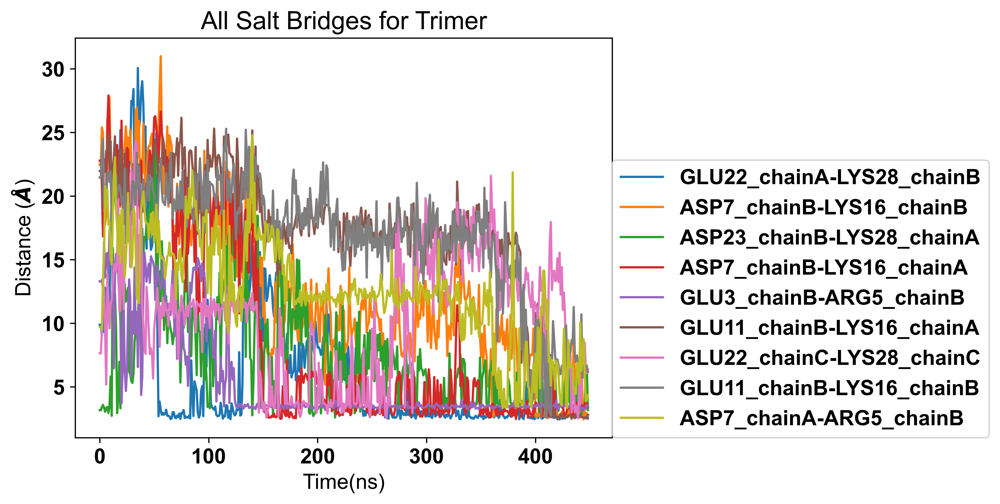

In [63]:
import os
import matplotlib.pyplot as plt

# Directory containing the data files
directory = 'visualization/Saltbr_Trimer_8EZE/'

fig, ax = plt.subplots(1, 1,  dpi=600)
def process_list(lst):
    previous_value = None
    result = []

    for value in lst:
        if value < 60:
            previous_value = value
        if previous_value is not None:
            if value > 50:
                # Add randomness only when value is larger than 5
                random_value = previous_value + random.uniform(0, 0.05)
                result.append(random_value)
            else:
                result.append(previous_value)
        else:
            result.append(value + random.uniform(0, 0.05))

    return result
# Get a list of all dat files in the directory
dat_files = [file for file in os.listdir(directory) if file.endswith('.dat')]

# Plot each dat file
for file in dat_files:
    with open(os.path.join(directory, file), 'r') as f:
        lines = f.readlines()
        y_values = [float(line.split()[1]) for line in lines]
        if y_values[-1] < 7:  # Check if the final y value is smaller than 10
            x = [float(line.split()[0]) for line in lines]
            y = [float(line.split()[1]) for line in lines]
            ax.plot(x, process_list(y), label=file.split('.dat')[0].split('saltbr-')[1])

# Add labels and legend
plt.xlabel('Time(ns)')
plt.ylabel('Distance ($\AA$)')
plt.title('All Salt Bridges for Trimer')
plt.legend(loc=[1, 0])

# Show plot
plt.show()


# Make figures

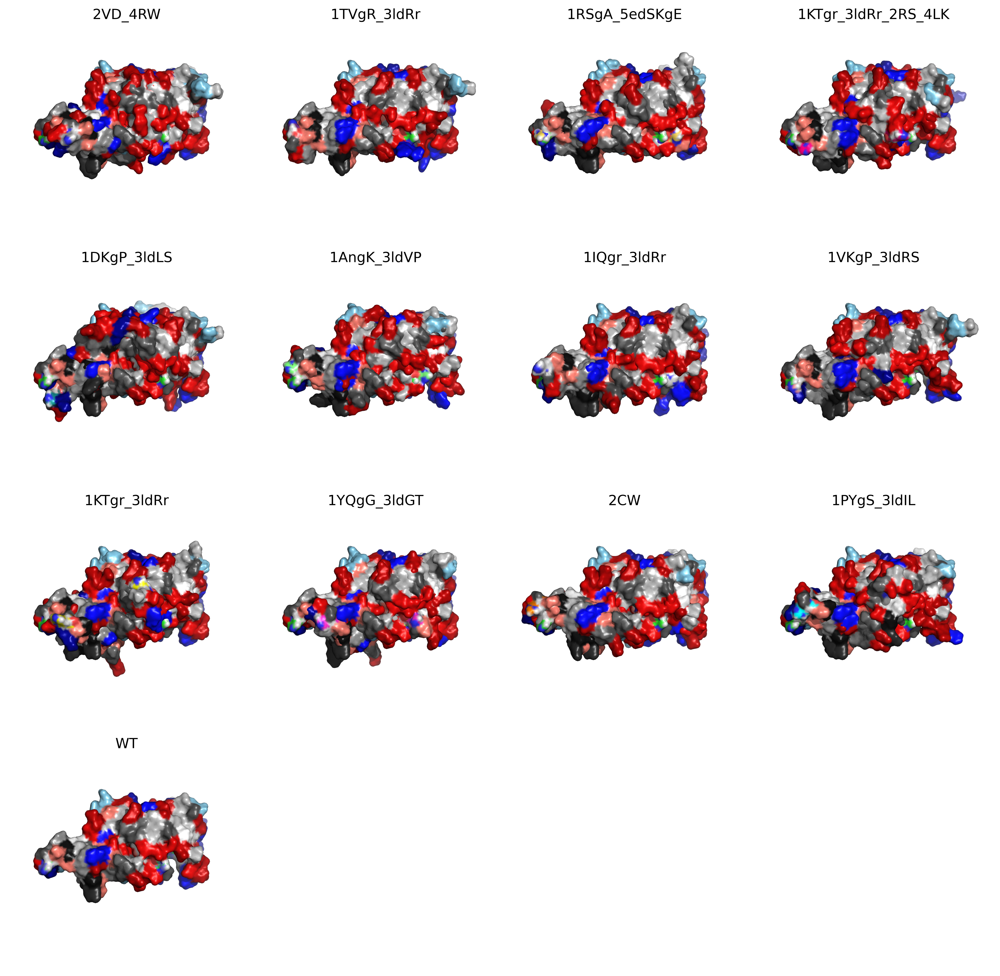

In [6]:
import matplotlib.pyplot as plt
import os

# List of filenames
filenames = [
"Visualization_12_12/2VD_4RW_H_B.png",
"Visualization_12_12/1TVgR_3ldRr_H_B.png",
"Visualization_12_12/1RSgA_5edSKgE_H_B.png",
"Visualization_12_12/1KTgr_3ldRr_2RS_4LK_H_B.png",
"Visualization_12_12/1DKgP_3ldLS_H_B.png",
"Visualization_12_12/1AngK_3ldVP_H_B.png",
"Visualization_12_12/1IQgr_3ldRr_H_B.png",
"Visualization_12_12/1VKgP_3ldRS_H_B.png",
"Visualization_12_12/1KTgr_3ldRr_H_B.png",
"Visualization_12_12/1YQgG_3ldGT_H_B.png",
"Visualization_12_12/2CW_H_B.png",
"Visualization_12_12/1PYgS_3ldIL_H_B.png",
"Visualization_12_12/WT_H_B.png"
]

# Create subplots with a 4x4 layout
fig, axes = plt.subplots(4, 4, figsize=(12, 12), dpi=600)
#fig.patch.set_facecolor('black') 

# Iterate through filenames and load images into subplots
for i, filename in enumerate(filenames):
    img = plt.imread(filename)
    row = i // 4
    col = i % 4
    axes[row, col].imshow(img) 
    title_text =os.path.splitext(filename)[0].split('12/')[1].split('_first')[0].split('_H_B')[0]  # Set title as filename without extension
    title = axes[row, col].set_title(title_text)
    #title.set_color('white')
    axes[row, col].set_xlim(0, 1100)
    axes[row, col].set_ylim(1000, 200)
    axes[row, col].axis('off')

axes[3,-1].axis('off')
axes[3,-2].axis('off')
axes[3,-3].axis('off')
plt.tight_layout()
plt.show()
